<div class="usecase-title">Foot Traffic Analysis: Analyse the city's foot traffic activities during the night time specifically (night economy). The purpose is to analyse/track the city's night time activity that associated with city plan to revive the night economy. ideally analyse the foot traffic on 1 hour interval.</div>

<div class="usecase-authors"><b>Authored by: </b>Te' Claire</div>

<div class="usecase-date"><b>Date: </b> March-July 2024</div>

<div class="usecase-duration"><b>Duration:</b> 90 mins</div>

<div class="usecase-level-skill">
    <div class="usecase-level"><b> Level: </b>Intermediate</div>
    <div class="usecase-skill"><b> Pre-requisite Skills: </b>Python, basic machine learning, <i>Optional</i> Google Collaborate access</div>
</div>

<div class="usecase-subsection-blurb">
  <i>Dataset 1:</i> pedestrian-counting-system-sensor-locations 140 records
  <br>
  <a href="https://data.melbourne.vic.gov.au/explore/dataset/pedestrian-counting-system-sensor-locations/" target="_blank">Dataset Link</a>
  <br>
</div>
<br>

<div class="usecase-subsection-blurb">
  <i>Dataset 2:</i> on-street-parking-bays 19162 records
  <br>
  <a href="https://data.melbourne.vic.gov.au/explore/dataset/on-street-parking-bays/table/" target="_blank">Dataset Link</a>
  <br>
</div>
<br>

<div class="usecase-subsection-blurb">
  <i>Dataset 3:</i> pedestrian-counting-system-monthly-counts-per-hour 549976 records
  <br>
  <a href="https://data.melbourne.vic.gov.au/explore/dataset/pedestrian-counting-system-monthly-counts-per-hour/" target="_blank">Dataset Link</a>
  <br>
</div>
<br>

<div class="usecase-subsection-blurb">
  <i>Dataset 4:</i> pedestrian-network 85326 records
  <br>
  <a href="https://data.melbourne.vic.gov.au/explore/dataset/pedestrian-network/" target="_blank">Dataset Link</a>
  <br>
  <br>

<div class="usecase-subsection-blurb">
  <i>Dataset 4:</i> (5) Business establishments location and industry classification 374210 records
  <br>
  <a href="https://data.melbourne.vic.gov.au/explore/dataset/business-establishments-with-address-and-industry-classification/information/" target="_blank">Dataset Link</a>
</div>
<br>

# <div class="usecase-section-header"><h4>Project Objective, Overview & Research</h4></div>

##### Context: To promote night economy by boosting local businesses and activities after hours in Melbourne City (7pm-7am). This use case examines pedestrian movement patterns during nighttime to support future planning and potential strategies that can be used for businesses in the area.

<br>

##### Objective: To track the city's nighttime foot traffic in order to identify active zones, time slots, and potential areas for development to stimulate the night economy.

<br>

*   As a city council member, I want to analyze and understand the patterns of
nighttime foot traffic in Melbourne so that I can develop effective policies and initiatives to boost the Melbourne night scene and ensure safety and enjoyment for both residents and visitors.
*   As a resident in Melbourne, I want to see the city's nighttime foot traffic so that I can identify areas which would suit my lifestyle, ultimately supporting local businesses.


##### Deliverables:
1. A detailed report containing the analysis of nighttime foot traffic, including graphical content.
2. Key findings and proposed strategies based on data.

#### Part 1
###### `Data Preprocessing`:
1. Combine datasets to identify pedestrian traffic (locations, counts, & network paths).
2. Clean (normalise) the data.

###### `Temporal Analysis`:
1. Outline pedestrian counts during hourly intervals nighttime (6 PM to 6 AM).
2. Identify peak activity times.

<br>

#### Part 2
###### `Spatial Analysis`: Map pedestrian counts using pedestrian network data to identify high vs low traffic areas (Pedestrian Counting System (sensors), (counts per hour) and Pedestrian Network)

###### `Trend Analysis`: Identity monthly and yearly analysis to find trends of nighttime foot traffic using sensors and pedestrain traffic. Additionally find parking locations that are nearby that would extend foot traffic areas (On Street Parking Bays).

###### `Strategic Planning`: Identifiy strategic locations for new businesses to assist in public transportation, (Business establishents location and industry classification).

---

### Set up

In [1]:
# Dependencies
import warnings
warnings.filterwarnings("ignore")

import requests
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)

In [2]:
# Lib
!pip install geopandas
import time
import sys
from io import StringIO

from datetime import datetime, date
import numpy as np
from tqdm.auto import tqdm
import pandas as pd
import geopandas
import json
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
from shapely.geometry import Point

import geopandas as gpd
import folium
from folium.plugins import MarkerCluster
from scipy.spatial import cKDTree
from ipywidgets import interact_manual, Dropdown, Button, VBox

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 13.7 MB/s eta 0:00:00


In [60]:
!pip install plotly

In [3]:
from google.colab import drive
drive.mount('/content/drive')
with open('/content/drive/My Drive/SIT378/h.txt', 'r') as file:
    api_key = file.read().strip()

import os
api_key = os.getenv(api_key)

Mounted at /content/drive


In [4]:
# Define the company colors
color_d = ['#08af64', '#14a38e', '#0f9295', '#056b8a', '#121212'] #Dark theme
color_d_extend = ['#00918D', '#007E87', '#008883', '#0C5D70', '#51C293', '#008C9E', '#08af64', '#14a38e', '#0f9295', '#056b8a', '#121212']
color_night = ['#121212']
color_white = ['#B6B8D6']
color_l = ['#2af598', '#22e4ac', '#1bd7bb', '#14c9cb', '#0fbed8', '#08b3e5'] #Light theme
color_median = ['#9f1b04', '#7f10d0', '#cc8400', '#e480a1', '#4a71c7']

###### Load Dataset
- pedestrian-counting-system-monthly-counts-per-hour

In [8]:
# Download datasets
def download_dataset(api_key, dataset_id, base_url='https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'):
    format = 'csv'
    url = f'{base_url}{dataset_id}/exports/{format}'
    params = {
        'select': '*',
        'limit': -1,  # all records
        'lang': 'en',
        'timezone': 'UTC',
        'api_key': api_key
    }

    with requests.get(url, params=params, stream=True) as response:
        if response.status_code == 200:
            total_size = int(response.headers.get('content-length', 0))
            chunk_size = 1024  # 1KB per chunk
            progress_bar = tqdm(total=total_size, unit='iB', unit_scale=True, desc=f"Downloading {dataset_id}")

            content = bytearray()
            for chunk in response.iter_content(chunk_size=chunk_size):
                if chunk:  # filter out keep-alive new chunks
                    content.extend(chunk)
                    progress_bar.update(len(chunk))

            progress_bar.close()
            data = pd.read_csv(StringIO(content.decode('utf-8')), delimiter=';')
            return data
        else:
            print(f'Request failed with status code {response.status_code}')
            return None

# Dataset IDs
dataset_ids = [
    'pedestrian-counting-system-monthly-counts-per-hour',
    'on-street-parking-bays',
    'pedestrian-network',
    'pedestrian-counting-system-sensor-locations',
    'business-establishments-with-address-and-industry-classification'
]

# Initialize dictionary to hold the datasets
datasets = {}

# Download each dataset with a progress bar
for dataset_id in dataset_ids:
    datasets[dataset_id] = download_dataset(api_key, dataset_id)
    if datasets[dataset_id] is not None:
        print(f"{dataset_id} downloaded successfully.")


pedestrian-counting-system-monthly-counts-per-hour downloaded successfully.


on-street-parking-bays downloaded successfully.


pedestrian-network downloaded successfully.


pedestrian-counting-system-sensor-locations downloaded successfully.


business-establishments-with-address-and-industry-classification downloaded successfully.


### View Datasets

In [9]:
print(datasets['pedestrian-counting-system-monthly-counts-per-hour'].head())

  sensor_name                  timestamp  locationid  direction_1  \
0    RMIT14_T  2023-05-03T09:00:00+00:00          61          294   
1    RMIT14_T  2023-05-03T13:00:00+00:00          61           78   
2    Lat224_T  2023-05-02T14:00:00+00:00          62           63   
3    Lat224_T  2023-05-02T20:00:00+00:00          62           50   
4    Lat224_T  2023-05-02T21:00:00+00:00          62           61   

   direction_2  total_of_directions                    location  
0          379                  673  -37.80767455, 144.96309114  
1           64                  142  -37.80767455, 144.96309114  
2           46                  109  -37.80996494, 144.96216521  
3           27                   77  -37.80996494, 144.96216521  
4           42                  103  -37.80996494, 144.96216521  


In [10]:
print(datasets['on-street-parking-bays'].head())

   roadsegmentid kerbsideid  \
0          20751       8598   
1          20751       8604   
2          20751       8607   
3          22499       8624   
4          22499       8625   

                              roadsegmentdescription   latitude   longitude  \
0  Argyle Place South between Lygon Street and Ca... -37.803448  144.965682   
1  Argyle Place South between Lygon Street and Ca... -37.803428  144.965496   
2  Argyle Place South between Lygon Street and Ca... -37.803413  144.965361   
3  Queensberry Street between Lygon Street and Ca... -37.804688  144.965314   
4  Queensberry Street between Lygon Street and Ca... -37.804695  144.965379   

  lastupdated  
0  2023-05-28  
1  2023-05-28  
2  2023-05-28  
3  2023-05-28  
4  2023-05-28  


In [11]:
print(datasets['pedestrian-network'].head())

                          geo_point_2d  \
0  -37.791128630450004, 144.9250621319   
1    -37.790885197, 144.92478186034998   
2  -37.79063325525, 144.92244485650002   
3  -37.790601697949995, 144.9253671047   
4         -37.790968201, 144.942393422   

                                           geo_shape  objectid  neworkid  
0  {"coordinates": [[144.9251354935, -37.79109699...      5735       NaN  
1  {"coordinates": [[144.9247703611, -37.79089170...      5738       NaN  
2  {"coordinates": [[144.9224965319, -37.79068385...      5740       NaN  
3  {"coordinates": [[144.9254894579, -37.79073841...      5743       NaN  
4  {"coordinates": [[144.9424411919, -37.79097389...      5744       NaN  


In [12]:
print(datasets['pedestrian-counting-system-sensor-locations'].head())

   location_id                      sensor_description sensor_name  \
0           24           Spencer St-Collins St (North)    Col620_T   
1           25  Melbourne Convention Exhibition Centre      MCEC_T   
2           36                         Queen St (West)     Que85_T   
3           37                         Lygon St (East)    Lyg260_T   
4           41          Flinders La-Swanston St (West)       Swa31   

  installation_date                         note location_type status  \
0        2013-09-02                          NaN       Outdoor      A   
1        2013-08-28                          NaN       Outdoor      A   
2        2015-01-20  Pushbox Upgrade, 03/08/2023       Outdoor      A   
3        2015-02-11  Pushbox Upgrade, 30/06/2023       Outdoor      A   
4        2017-06-29                          NaN       Outdoor      A   

  direction_1 direction_2   latitude   longitude                    location  
0        East        West -37.818880  144.954492  -37.8188796

In [13]:
print(datasets['business-establishments-with-address-and-industry-classification'].head())

   census_year  block_id  property_id  base_property_id  clue_small_area  \
0         2004        44       108110            108110  Melbourne (CBD)   
1         2004        44       108110            108110  Melbourne (CBD)   
2         2004        44       108111            108111  Melbourne (CBD)   
3         2004        44       108111            108111  Melbourne (CBD)   
4         2004        44       108111            108111  Melbourne (CBD)   

              trading_name                                   business_address  \
0  Total Tel International   Part Level 12, 140-0 Queen Street MELBOURNE 3000   
1          CJ Ham & Murray      Part Floor 2, 140 Queen Street MELBOURNE 3000   
2    Netherlands Consulate  Suite 7, Part Level 4, 118-126 Queen Street ME...   
3       Thomas Koutsoupias  Suite 10, Level 9, 118-126 Queen Street MELBOU...   
4           K S T Partners  Suite 4, Floor 5, 118 Queen Street MELBOURNE 3000   

   industry_anzsic4_code       industry_anzsic4_descript

## A. Save datasets locally

In [14]:
# Save
base_path = '/content/drive/My Drive/sit378_foot_traffic_analysis/'

for dataset_id, df in datasets.items():
    if df is not None:
        filename = f"{base_path}{dataset_id}.csv"
        df.to_csv(filename, index=False)
        print(f"Saved {filename} to Google Drive.")

Saved /content/drive/My Drive/sit378_foot_traffic_analysis/pedestrian-counting-system-monthly-counts-per-hour.csv to Google Drive.
Saved /content/drive/My Drive/sit378_foot_traffic_analysis/on-street-parking-bays.csv to Google Drive.
Saved /content/drive/My Drive/sit378_foot_traffic_analysis/pedestrian-network.csv to Google Drive.
Saved /content/drive/My Drive/sit378_foot_traffic_analysis/pedestrian-counting-system-sensor-locations.csv to Google Drive.
Saved /content/drive/My Drive/sit378_foot_traffic_analysis/business-establishments-with-address-and-industry-classification.csv to Google Drive.


## B. Load datasets

In [15]:
# Load
base_path = '/content/drive/My Drive/sit378_foot_traffic_analysis/'
datasets = {} # Dictionary

# Filenames
dataset_filenames = {
    'pedestrian_hour': 'pedestrian-counting-system-monthly-counts-per-hour.csv',
    'on_street_parking': 'on-street-parking-bays.csv',
    'pedestrian-network': 'pedestrian-network.csv',
    'pedestrian-counting-system-sensor-locations': 'pedestrian-counting-system-sensor-locations.csv',
    'business-establishments-with-address-and-industry-classification': 'business-establishments-with-address-and-industry-classification.csv'
}

# Load each dataset into the datasets dictionary
for dataset_id, filename in dataset_filenames.items():
    full_path = f"{base_path}{filename}"
    datasets[dataset_id] = pd.read_csv(full_path)
    print(f"Loaded {dataset_id} with {datasets[dataset_id].shape[0]} records.")

Loaded pedestrian_hour with 549976 records.
Loaded on_street_parking with 19162 records.
Loaded pedestrian-network with 85326 records.
Loaded pedestrian-counting-system-sensor-locations with 140 records.
Loaded business-establishments-with-address-and-industry-classification with 374210 records.


In [20]:
# Dataframes
pedestrian_hour = datasets['pedestrian_hour']
on_street_parking = datasets['on_street_parking']
pedestrian_network = datasets['pedestrian-network']
sensor_locations = datasets['pedestrian-counting-system-sensor-locations']
business_establishments = datasets['business-establishments-with-address-and-industry-classification']

###### Data Preprocessing:
1. Combine datasets to identify pedestrian traffic (locations, counts, & network paths).
2. Clean (normalise) the data.

In [22]:
# Check missing values for dataset
print('pedestrian_network')
print(pedestrian_network.isnull().sum())
print("#" * 30)
print()

print('on_street_parking')
print(on_street_parking.isnull().sum())
print("#" * 30)
print()

print('pedestrian_hour')
print(pedestrian_hour.isnull().sum())
print("#" * 30)
print()

print('sensor_locations')
print(sensor_locations.isnull().sum())
print("#" * 30)

print('business_establishments')
print(business_establishments.isnull().sum())
print("#" * 30)

pedestrian_network
geo_point_2d        0
geo_shape           0
objectid            0
neworkid        71060
dtype: int64
##############################

on_street_parking
roadsegmentid                 0
kerbsideid                14149
roadsegmentdescription        0
latitude                      0
longitude                     0
lastupdated                   0
dtype: int64
##############################

pedestrian_hour
sensor_name            0
timestamp              0
locationid             0
direction_1            0
direction_2            0
total_of_directions    0
location               0
dtype: int64
##############################

sensor_locations
location_id             0
sensor_description      0
sensor_name             0
installation_date       2
note                  107
location_type           0
status                  0
direction_1            43
direction_2            43
latitude                0
longitude               0
location                0
dtype: int64
###############

### Data Cleaning
- Find missing data
  - pedestrian_network 85326 | missing 71060 network ids = 83.28% drop
  - on_street_parking 19162 | misisng 14149 kerbsideid = 73.84% drop
  - pedestrian_hour no NaNs
  - sensor 140 | missing note 107 = 76.43% drop
  - sensor 140 | missing direction_1 43 & direction_2 43 = 30.71% (attempt to clean)
  - business_locations 374210 | missing long/ lat 4785 = 1.28% drop
  - business_locations 374210 | missing trading_name 127 = 0.03% drop
- Merge dataframes (pedestrian hour and sensor locations)
- Creat a GeoDataFrame for pedestrian Network

In [23]:
# pedestrian_network drop
pedestrian_network = pedestrian_network.drop(columns=['neworkid'])
# on_street_parking drop
on_street_parking = on_street_parking.drop(columns=['kerbsideid'])
# sensor drop
sensor = sensor_locations.drop(columns=['note', 'installation_date'])

In [25]:
# Business establishments drop
business_establishments.dropna(subset=['business_address', 'trading_name', 'longitude', 'latitude'], inplace=True)

In [28]:
# Merge sensor_name
pedestrian_hour_sensor = pd.merge(pedestrian_hour, sensor_locations, on='sensor_name', how='left')
print(pedestrian_hour_sensor.head())

  sensor_name                  timestamp  locationid  direction_1_x  \
0    RMIT14_T  2023-05-03T09:00:00+00:00          61            294   
1    RMIT14_T  2023-05-03T13:00:00+00:00          61             78   
2    Lat224_T  2023-05-02T14:00:00+00:00          62             63   
3    Lat224_T  2023-05-02T20:00:00+00:00          62             50   
4    Lat224_T  2023-05-02T21:00:00+00:00          62             61   

   direction_2_x  total_of_directions                  location_x  \
0            379                  673  -37.80767455, 144.96309114   
1             64                  142  -37.80767455, 144.96309114   
2             46                  109  -37.80996494, 144.96216521   
3             27                   77  -37.80996494, 144.96216521   
4             42                  103  -37.80996494, 144.96216521   

   location_id   sensor_description installation_date note location_type  \
0         61.0     RMIT Building 14        2019-06-28  NaN       Outdoor   
1     

In [29]:
# split geo_point in lat/long
pedestrian_network = pd.DataFrame(pedestrian_network)
pedestrian_network[['lat', 'lon']] = pedestrian_network['geo_point_2d'].str.split(',', expand=True)
# print(pedestrian_network)

In [30]:
# GeoDataFrame
geometry = [Point(lon, lat) for lon, lat in zip(pedestrian_network['lon'], pedestrian_network['lat'])]
gpd_pedestrianpath = gpd.GeoDataFrame(pedestrian_network, geometry=geometry, crs="EPSG:4326")
gpd_pedestrianpath.drop(columns=['lat', 'lon'], inplace=True)
# print(gpd_pedestrianpath)

### Overview Pedestrian Paths
- Overview of day and night data
  - Review specific sensor points (ACMI)
  - Review all sensor locations

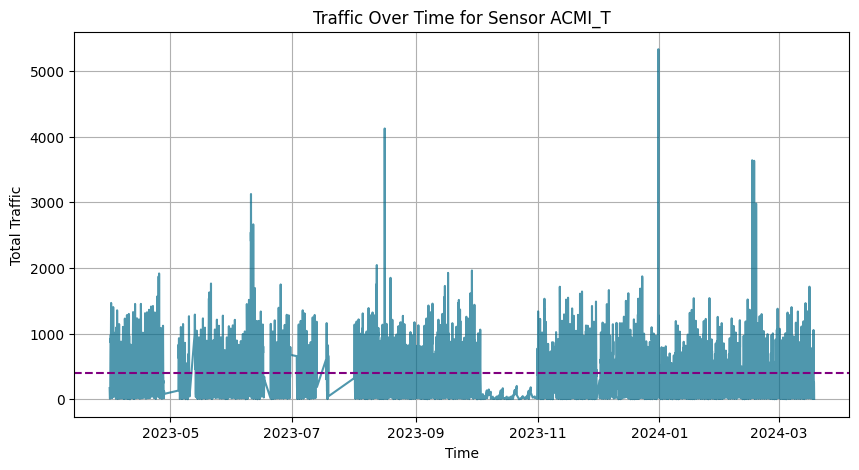

In [32]:
# Specific location traffic ACMI
pedestrian_hour_sensor['timestamp'] = pd.to_datetime(pedestrian_hour_sensor['timestamp'])
specific_sensor_data_acmi_day_night = pedestrian_hour_sensor[pedestrian_hour_sensor['sensor_name'] == 'ACMI_T']
specific_sensor_data_acmi_day_night = specific_sensor_data_acmi_day_night.groupby('timestamp')['total_of_directions'].sum()

# Plot
plt.figure(figsize=(10, 5))
plt.plot(specific_sensor_data_acmi_day_night.index, specific_sensor_data_acmi_day_night.values, color=color_d[3], alpha=0.7)
plt.axhline(specific_sensor_data_acmi_day_night.mean(), color='purple', linestyle='--', label='Avg ACMI_T Traffic')
plt.title('Traffic Over Time for Sensor ACMI_T')
plt.xlabel('Time')
plt.ylabel('Total Traffic')
plt.grid(True)
plt.show()

In [33]:
specific_sensor_data_acmi_day_night.describe()

count    6950.000000
mean      405.964604
std       377.874285
min         1.000000
25%        59.000000
50%       347.500000
75%       636.000000
max      5331.000000
Name: total_of_directions, dtype: float64

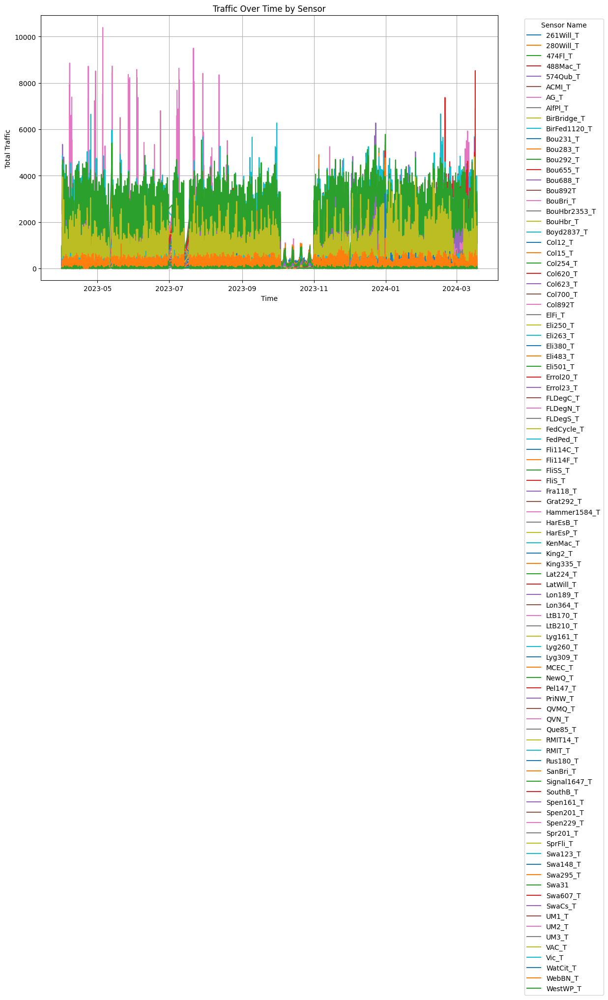

In [35]:
# Group data (Sensor and timestamp + traffic)
grouped_data_day_night = pedestrian_hour_sensor.groupby(['sensor_name', 'timestamp'])['total_of_directions'].sum().unstack(0)

# Multiple sensors
plt.figure(figsize=(12, 7))
for sensor in grouped_data_day_night.columns:
    plt.plot(grouped_data_day_night.index, grouped_data_day_night[sensor], label=sensor)

plt.title('Traffic Over Time by Sensor')
plt.xlabel('Time')
plt.ylabel('Total Traffic')
plt.legend(title='Sensor Name', loc='upper left', bbox_to_anchor=(1.05, 1))

plt.grid(True)
plt.tight_layout()
plt.show()

In [37]:
grouped_data_day_night.describe()

sensor_name,261Will_T,280Will_T,474Fl_T,488Mac_T,574Qub_T,ACMI_T,AG_T,AlfPl_T,BirBridge_T,BirFed1120_T,Bou231_T,Bou283_T,Bou292_T,Bou655_T,Bou688_T,Bou892T,BouBri_T,BouHbr2353_T,BouHbr_T,Boyd2837_T,Col12_T,Col15_T,Col254_T,Col620_T,Col623_T,Col700_T,Col892T,ElFi_T,Eli250_T,Eli263_T,Eli380_T,Eli483_T,Eli501_T,Errol20_T,Errol23_T,FLDegC_T,FLDegN_T,FLDegS_T,FedCycle_T,FedPed_T,Fli114C_T,Fli114F_T,FliSS_T,FliS_T,Fra118_T,Grat292_T,Hammer1584_T,HarEsB_T,HarEsP_T,KenMac_T,King2_T,King335_T,Lat224_T,LatWill_T,Lon189_T,Lon364_T,LtB170_T,LtB210_T,Lyg161_T,Lyg260_T,Lyg309_T,MCEC_T,NewQ_T,Pel147_T,PriNW_T,QVMQ_T,QVN_T,Que85_T,RMIT14_T,RMIT_T,Rus180_T,SanBri_T,Signal1647_T,SouthB_T,Spen161_T,Spen201_T,Spen229_T,Spr201_T,SprFli_T,Swa123_T,Swa148_T,Swa295_T,Swa31,Swa607_T,SwaCs_T,UM1_T,UM2_T,UM3_T,VAC_T,Vic_T,WatCit_T,WebBN_T,WestWP_T
count,6687.000000,6184.000000,2651.000000,6682.000000,6757.000000,6950.000000,7445.000000,6241.000000,3316.000000,2575.000000,6926.000000,7187.000000,7033.000000,462.000000,7484.000000,569.000000,4606.000000,2457.000000,7159.000000,1546.000000,6559.000000,7464.000000,7462.000000,7414.000000,6920.000000,7014.000000,1211.000000,7004.000000,6939.000000,6928.000000,5698.000000,2736.000000,6553.000000,7287.000000,7269.000000,6963.000000,6490.000000,7502.000000,5932.000000,5898.000000,6269.000000,7346.000000,7289.000000,7513.000000,6829.000000,435.000000,2844.000000,6772.000000,7124.000000,6738.000000,2827.000000,2860.000000,7427.000000,7210.000000,6855.000000,7337.000000,6836.000000,6730.000000,6916.000000,5241.000000,6854.000000,4414.000000,7469.000000,5842.000000,6468.000000,6594.000000,7436.000000,7117.000000,7282.000000,7511.000000,6489.000000,7382.000000,2349.000000,7243.000000,2861.000000,2815.000000,2861.000000,7135.000000,6086.000000,6994.000000,7160.000000,7515.000000,7472.000000,6951.000000,7235.000000,2073.000000,4293.000000,5007.000000,7297.000000,7142.000000,7024.000000,7190.000000,6857.000000
mean,405.031554,145.880821,197.830630,93.821610,56.637561,405.964604,348.342243,127.767505,39.319662,189.899417,419.493070,621.212745,1029.900754,216.751082,633.533137,40.920914,454.746852,55.475376,98.500629,142.347995,218.294405,362.817256,558.034575,830.636903,317.745087,466.085258,29.752271,1182.510137,913.928952,389.096276,1079.430151,456.206871,253.499161,162.296693,110.055991,165.005170,194.966256,466.077446,70.864295,248.417430,30.613814,230.622380,625.592400,852.287901,131.679748,175.501149,590.021449,63.215741,177.753930,67.045562,158.435798,170.997552,228.006598,206.950485,425.607877,287.292899,326.314950,541.796137,199.646906,109.136424,224.931719,670.590847,222.686705,93.192229,1165.311843,245.925842,1099.181818,224.142897,430.894946,724.985621,502.158114,370.187212,97.080885,1036.972663,493.621111,467.793961,670.765816,216.667134,73.726914,1488.440520,678.308520,1199.210379,1705.917827,186.873687,566.151486,183.835986,146.238994,142.372678,722.608058,136.041865,111.940632,200.096245,25.356278
std,485.143904,119.553327,133.239904,75.655576,46.290549,377.874285,457.730530,129.570908,60.352792,369.432044,317.611887,687.371979,1070.424036,196.006709,522.747853,34.232105,901.958827,63.853127,108.192349,64.483945,282.589181,391.112846,540.030877,679.976485,301.395793,692.355900,23.689096,897.054660,749.464920,304.980070,786.829308,382.157033,229.062175,135.060428,93.371579,167.479003,172.956293,380.753253,81.348463,532.749304,25.876258,211.831268,473.330632,673.099758,103.250481,253.103878,612.136901,89.192001,180.779591,54.838090,117.788533,123.354520,160.970999,194.081081,319.310837,224.216332,308.146188,480.042581,185.554694,121.354154,201.667438,640.030338,255.124785,91.367629,1026.952150,253.494147,1004.418646,189.143552,386.177077,724.689877,401.832270,301.606842,97.471698,842.000843,417.407065,327.527708,451.525393,202.739631,61.797717,1330.923215,594.778154,971.001614,1300.803204,172.244378,494.609776,222.579035,189.299122,153.457336,697.376112,121.383867,124.540049,184.142205,24.552942
min,1.0000

###  Filter Data by Night Traffic 7pm-7am
- There are 310256 out of 549976 records = 56.41% of dataset








###### Temporal Analysis:
1. Outline pedestrian counts during hourly intervals nighttime (7 PM to 6 AM).
2. Identify peak activity times.
3. Explore weekday & weekend traffic to understand different patterns.

In [39]:
# Convert datetime format
pedestrian_hour_sensor['timestamp'] = pd.to_datetime(pedestrian_hour_sensor['timestamp'])

# Set condition
pedestrian_hour_sensor['hour'] = pedestrian_hour_sensor['timestamp'].dt.hour
nighttime_data = pedestrian_hour_sensor[(pedestrian_hour_sensor['hour'] >= 19) | (pedestrian_hour_sensor['hour'] <= 7)]

In [40]:
# Display nighttime data
print(nighttime_data.head())

nighttime_data_len = len(nighttime_data)
print(f'The dataset contains {nighttime_data_len} records.')

  sensor_name                 timestamp  locationid  direction_1_x  \
3    Lat224_T 2023-05-02 20:00:00+00:00          62             50   
4    Lat224_T 2023-05-02 21:00:00+00:00          62             61   
5    Lat224_T 2023-05-02 23:00:00+00:00          62            106   
6    Lat224_T 2023-05-03 02:00:00+00:00          62            211   
7    Lat224_T 2023-05-03 03:00:00+00:00          62            191   

   direction_2_x  total_of_directions                  location_x  \
3             27                   77  -37.80996494, 144.96216521   
4             42                  103  -37.80996494, 144.96216521   
5             79                  185  -37.80996494, 144.96216521   
6            147                  358  -37.80996494, 144.96216521   
7            108                  299  -37.80996494, 144.96216521   

   location_id   sensor_description installation_date note location_type  \
3         62.0  La Trobe St (North)        2019-09-25  NaN       Outdoor   
4         62

In [43]:
# Find heaviest traffic locations
# Group (location and hour) = total traffic
traffic_per_location_hour = nighttime_data.groupby(['location_x'])['total_of_directions'].sum().reset_index()

# Heaviest locations/ times
heaviest_locations_times = traffic_per_location_hour.sort_values(by='total_of_directions', ascending=False).head()
print(heaviest_locations_times)

                    location_x  total_of_directions
57  -37.81668634, 144.96689733              9228807
48   -37.81487988, 144.9660878              7709868
70  -37.81798049, 144.96503383              5817965
40  -37.81349441, 144.96515323              5736479
24  -37.81057846, 144.96444294              5673737


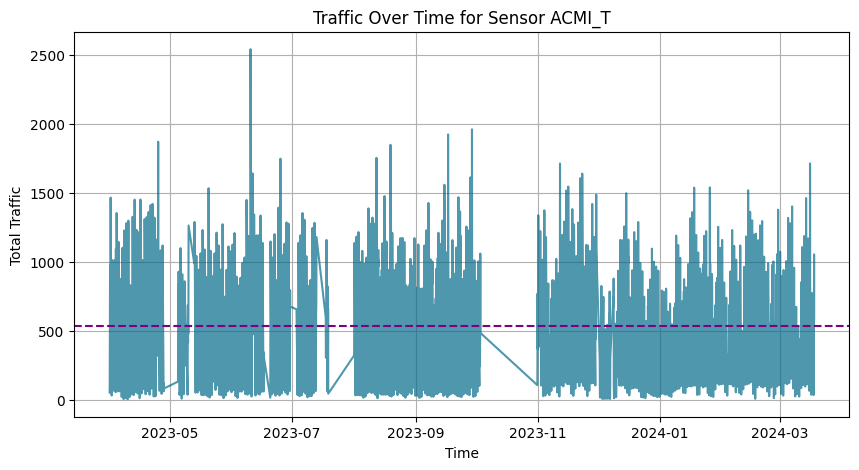

In [44]:
# Look at time sequence of data for ACMI Traffic NIGHT
specific_sensor_data_acmi_night = nighttime_data[nighttime_data['sensor_name'] == 'ACMI_T']
specific_sensor_data_acmi_night = specific_sensor_data_acmi_night.groupby('timestamp')['total_of_directions'].sum()

# Plot
plt.figure(figsize=(10, 5))
plt.plot(specific_sensor_data_acmi_night.index, specific_sensor_data_acmi_night.values, color=color_d[3], alpha=0.7)
plt.axhline(specific_sensor_data_acmi_night.mean(), color='purple', linestyle='--', label='Avg ACMI_T Traffic')
plt.title('Traffic Over Time for Sensor ACMI_T')
plt.xlabel('Time')
plt.ylabel('Total Traffic')
plt.grid(True)
plt.show()

In [45]:
specific_sensor_data_acmi_night.describe()

count    3731.000000
mean      535.459394
std       338.964905
min         5.000000
25%       279.000000
50%       525.000000
75%       748.500000
max      2543.000000
Name: total_of_directions, dtype: float64

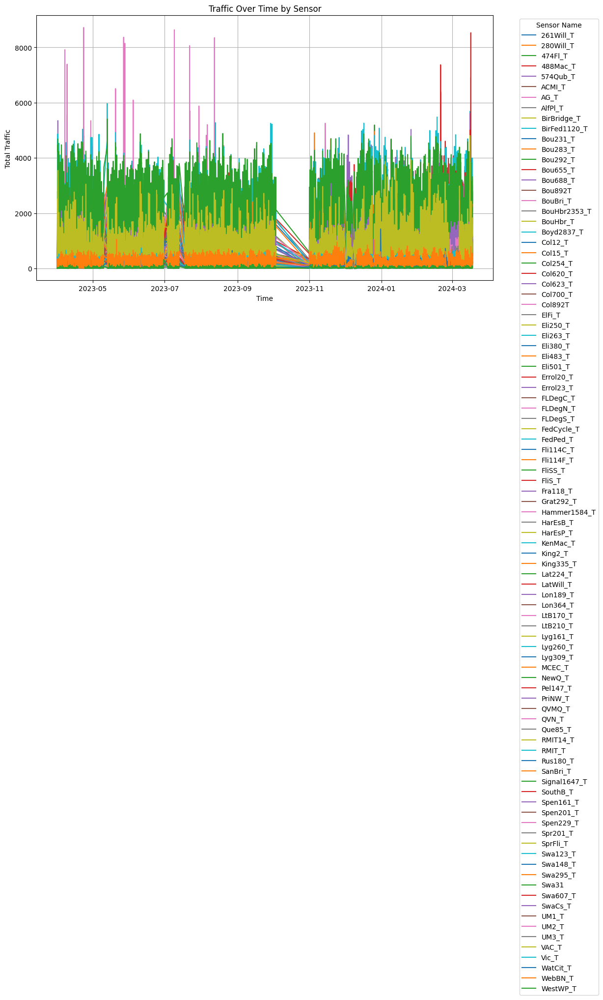

In [46]:
# Group data (Sensor and timestamp + traffic)
grouped_data = nighttime_data.groupby(['sensor_name', 'timestamp'])['total_of_directions'].sum().unstack(0)

# Multiple sensors
plt.figure(figsize=(12, 7))
for sensor in grouped_data.columns:
    plt.plot(grouped_data.index, grouped_data[sensor], label=sensor)

plt.title('Traffic Over Time by Sensor')
plt.xlabel('Time')
plt.ylabel('Total Traffic')
plt.legend(title='Sensor Name', loc='upper left', bbox_to_anchor=(1.05, 1))

plt.grid(True)
plt.tight_layout()
plt.show()

In [47]:
# Remove NaN values
cleaned_nighttime_data = nighttime_data.dropna(subset=['latitude', 'longitude'])
mean_lat = cleaned_nighttime_data['latitude'].mean()
mean_lon = cleaned_nighttime_data['longitude'].mean()


map_folium = folium.Map(location=[mean_lat, mean_lon], zoom_start=13)
heat_data = [
    [row['latitude'], row['longitude'], row['total_of_directions']]
    for index, row in cleaned_nighttime_data.iterrows()
]

# HeatMap
HeatMap(heat_data, radius=15, max_zoom=13).add_to(map_folium)
map_folium.save('Nighttime_Pedestrian_Traffic.html')
map_folium

In [48]:
grouped_data.describe()

sensor_name,261Will_T,280Will_T,474Fl_T,488Mac_T,574Qub_T,ACMI_T,AG_T,AlfPl_T,BirBridge_T,BirFed1120_T,Bou231_T,Bou283_T,Bou292_T,Bou655_T,Bou688_T,Bou892T,BouBri_T,BouHbr2353_T,BouHbr_T,Boyd2837_T,Col12_T,Col15_T,Col254_T,Col620_T,Col623_T,Col700_T,Col892T,ElFi_T,Eli250_T,Eli263_T,Eli380_T,Eli483_T,Eli501_T,Errol20_T,Errol23_T,FLDegC_T,FLDegN_T,FLDegS_T,FedCycle_T,FedPed_T,Fli114C_T,Fli114F_T,FliSS_T,FliS_T,Fra118_T,Grat292_T,Hammer1584_T,HarEsB_T,HarEsP_T,KenMac_T,King2_T,King335_T,Lat224_T,LatWill_T,Lon189_T,Lon364_T,LtB170_T,LtB210_T,Lyg161_T,Lyg260_T,Lyg309_T,MCEC_T,NewQ_T,Pel147_T,PriNW_T,QVMQ_T,QVN_T,Que85_T,RMIT14_T,RMIT_T,Rus180_T,SanBri_T,Signal1647_T,SouthB_T,Spen161_T,Spen201_T,Spen229_T,Spr201_T,SprFli_T,Swa123_T,Swa148_T,Swa295_T,Swa31,Swa607_T,SwaCs_T,UM1_T,UM2_T,UM3_T,VAC_T,Vic_T,WatCit_T,WebBN_T,WestWP_T
count,3586.000000,3327.000000,1530.000000,3958.000000,3933.000000,3731.000000,4026.000000,3435.000000,2254.000000,1529.000000,3912.000000,3862.000000,3777.000000,275.000000,4022.000000,482.000000,2492.000000,1518.000000,4018.000000,1283.000000,3735.000000,4011.000000,4009.000000,3984.000000,3715.000000,3779.000000,921.000000,3766.000000,3722.000000,3717.000000,3054.000000,1481.000000,3517.000000,4023.000000,3990.000000,4003.000000,3939.000000,4035.000000,3260.000000,3262.000000,3842.000000,3965.000000,3916.000000,4035.000000,3668.000000,242.000000,1544.000000,3779.000000,3883.000000,3992.000000,1540.000000,1545.000000,4032.000000,3873.000000,3680.000000,3946.000000,3667.000000,3615.000000,3722.000000,2671.000000,3717.000000,2353.000000,4027.000000,3199.000000,3478.000000,3541.000000,3991.000000,3828.000000,3910.000000,4033.000000,3498.000000,3964.000000,1311.000000,3890.000000,1545.000000,1520.000000,1545.000000,3842.000000,3911.000000,3754.000000,3844.000000,4035.000000,4010.000000,3737.000000,3886.000000,1125.000000,2370.000000,2829.000000,3918.000000,3841.000000,3973.000000,3979.000000,3910.000000
mean,629.748187,201.645026,244.624183,132.501516,75.764048,535.459394,456.306508,191.729258,42.898846,246.925441,520.714980,944.864837,1518.792428,284.443636,909.681004,45.663900,626.301766,76.405138,144.150821,147.590803,352.106292,566.538519,854.022449,1168.702560,465.053836,766.144218,32.661238,1544.865905,1245.975819,489.076675,1239.858874,602.649561,334.457208,203.688292,156.185714,254.943542,277.417365,658.038414,103.372393,276.717964,37.036960,290.282724,806.263279,1118.902354,176.916303,272.528926,742.488990,92.705213,232.014164,94.951904,189.014935,213.370874,270.300099,298.086496,446.072011,350.760517,318.857649,597.624620,211.909995,121.311494,284.581921,962.633234,260.896697,131.709597,1508.672513,350.330133,1421.632924,302.190178,599.781841,1019.135383,564.717553,473.945005,131.681159,1300.905656,709.166990,619.333553,923.115858,318.114263,91.324469,2053.774108,865.913371,1405.671623,2301.448130,244.255285,749.660834,268.516444,216.841772,199.783669,1022.825676,189.714918,133.977599,304.007791,34.361893
std,544.441202,115.543745,122.390141,65.610870,42.733171,338.964905,410.223804,134.677347,57.937471,415.220644,313.594233,724.156548,1113.965827,206.029105,489.216999,34.788806,782.151896,67.192577,106.949289,62.097278,303.225704,411.828419,535.382931,663.258644,305.907573,794.422699,24.359497,844.738911,741.013040,294.992109,741.129674,398.789800,246.801118,118.161201,84.365990,161.887239,164.539900,351.485988,89.545951,474.080122,25.826181,187.411518,427.997479,646.674734,100.365119,296.367121,522.657156,84.378392,162.131461,48.879114,104.344411,105.686561,163.202178,203.678774,297.801102,212.805285,254.097162,466.046001,143.229281,92.904463,189.506062,627.780747,199.137259,98.332579,988.630444,252.217748,1033.494422,196.195153,400.429962,803.405590,391.390212,275.247562,92.613103,767.092085,365.422106,286.622676,335.823516,200.919768,55.714736,1354.066208,588.362919,978.025481,1199.987817,186.802965,477.294145,254.317045,216.812366,167.277220,697.702719,122.414057,97.497766,166.447969,26.063371
min,

In [49]:
# Mean traffic for each sensor
mean_traffic_per_sensor = grouped_data.mean()

# Traffic > 500
high_traffic_sensors = mean_traffic_per_sensor[mean_traffic_per_sensor > 1000]
print("Sensors with high average traffic:")
print(high_traffic_sensors)

# Traffic < 100
low_traffic_sensors = mean_traffic_per_sensor[mean_traffic_per_sensor < 100]
print("\nSensors with low average traffic:")
print(low_traffic_sensors)


Sensors with high average traffic:
sensor_name
Bou292_T    1518.792428
Col620_T    1168.702560
ElFi_T      1544.865905
Eli250_T    1245.975819
Eli380_T    1239.858874
FliS_T      1118.902354
PriNW_T     1508.672513
QVN_T       1421.632924
RMIT_T      1019.135383
SouthB_T    1300.905656
Swa123_T    2053.774108
Swa295_T    1405.671623
Swa31       2301.448130
VAC_T       1022.825676
dtype: float64

Sensors with low average traffic:
sensor_name
574Qub_T        75.764048
BirBridge_T     42.898846
Bou892T         45.663900
BouHbr2353_T    76.405138
Col892T         32.661238
Fli114C_T       37.036960
HarEsB_T        92.705213
KenMac_T        94.951904
SprFli_T        91.324469
WestWP_T        34.361893
dtype: float64


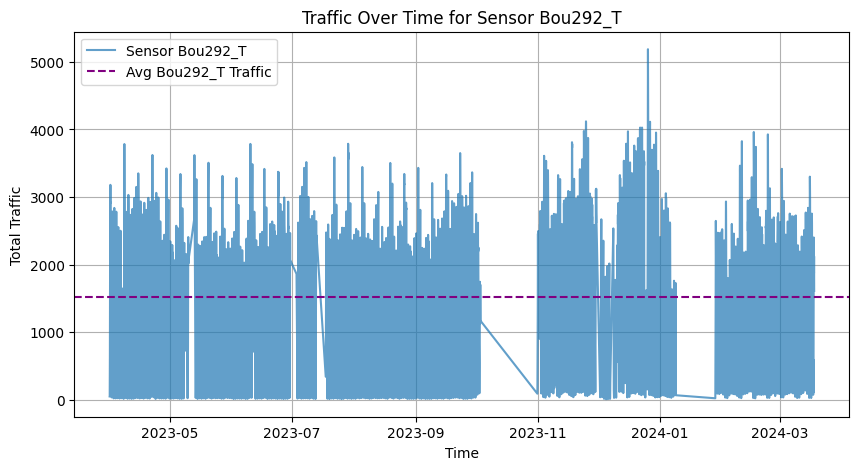

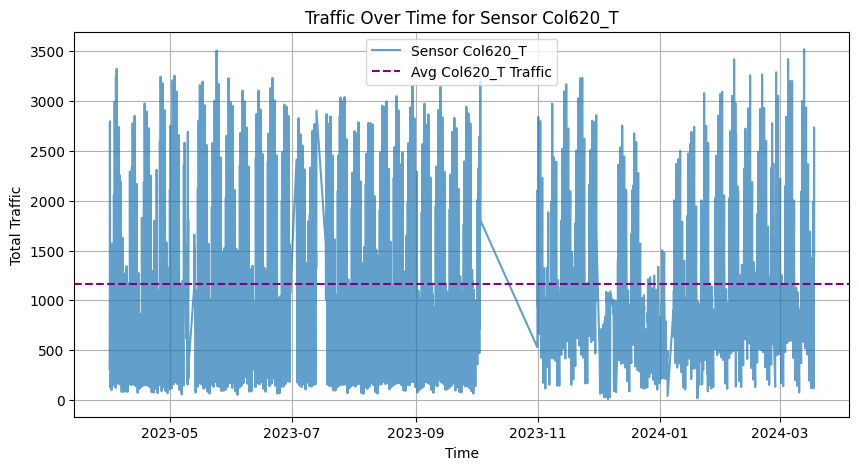

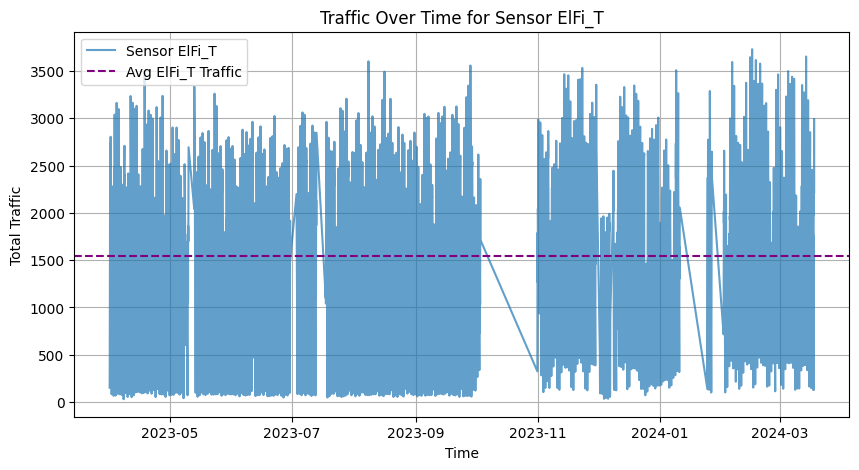

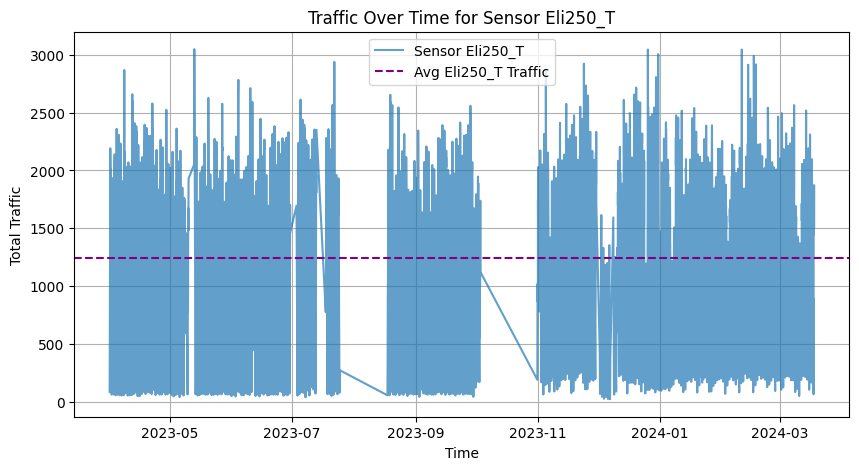

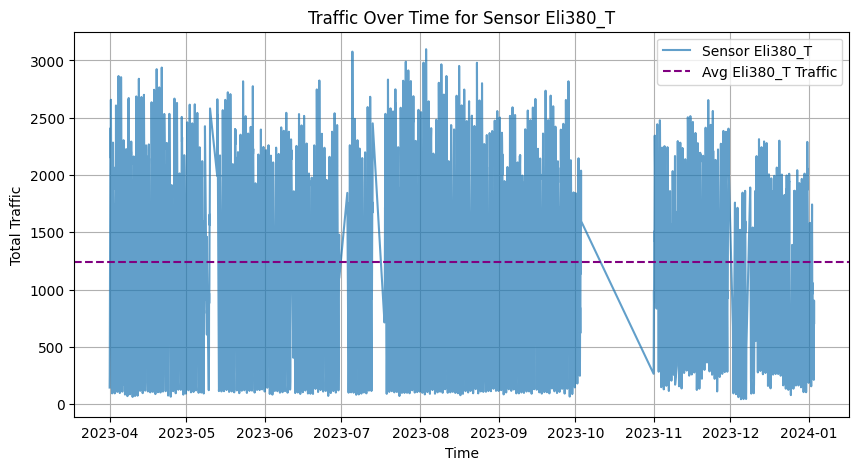

...

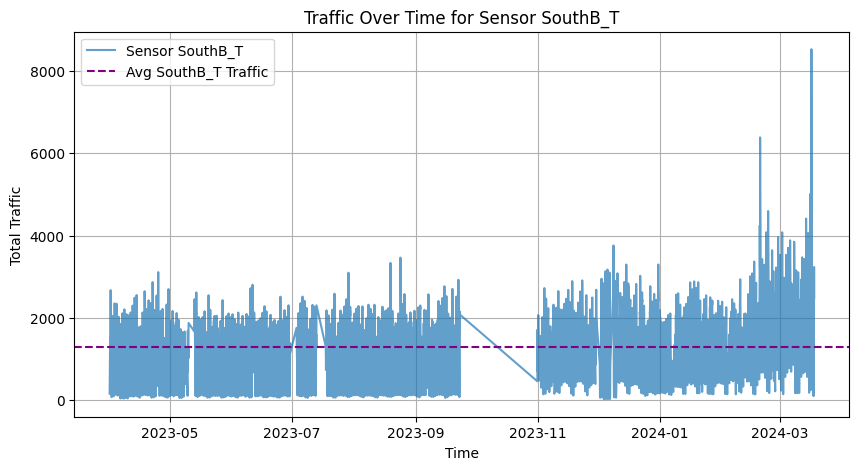

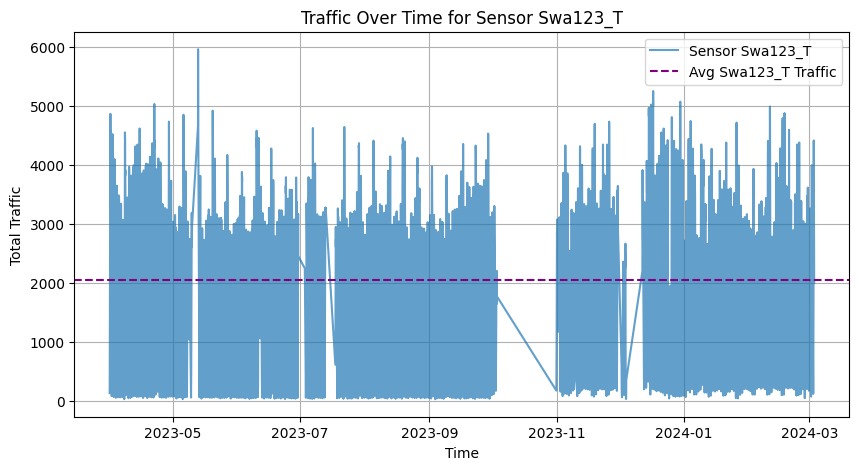

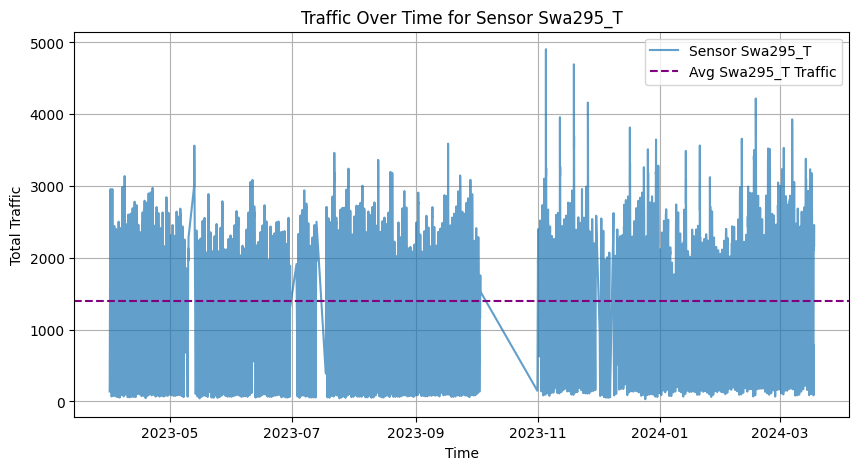

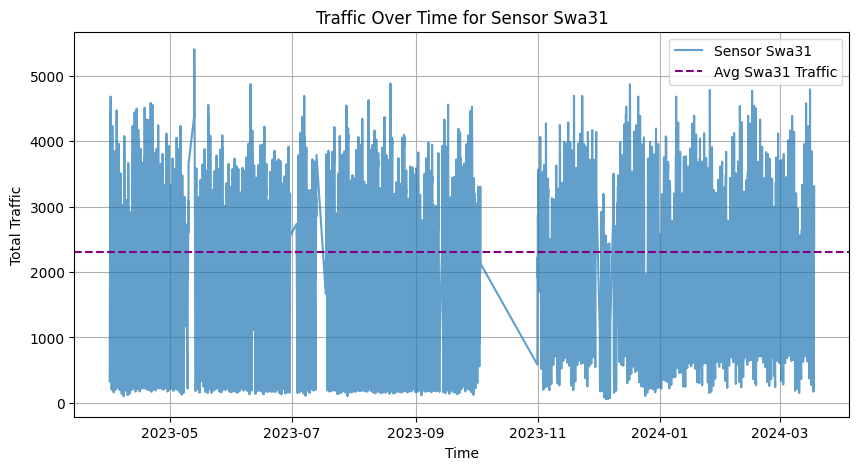

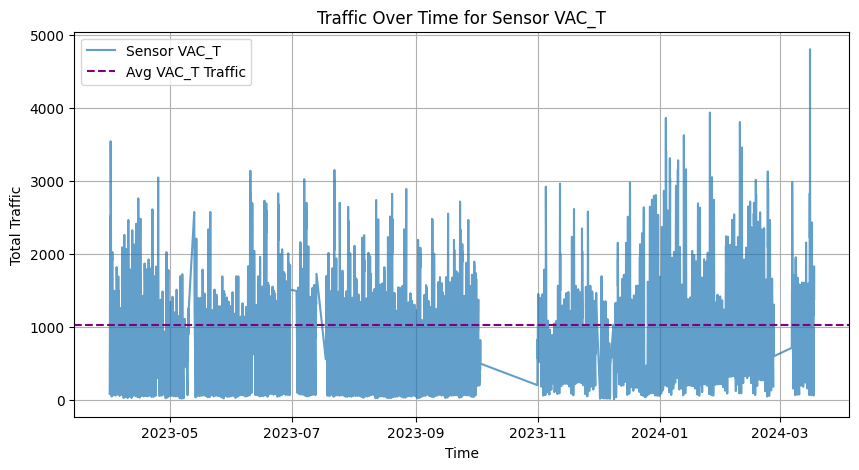

In [52]:
# Graph
for sensor_name in high_traffic_sensors.index:
    specific_sensor_data = nighttime_data[nighttime_data['sensor_name'] == sensor_name]
    specific_sensor_data = specific_sensor_data.groupby('timestamp')['total_of_directions'].sum()
    plt.figure(figsize=(10, 5))
    plt.plot(specific_sensor_data.index, specific_sensor_data.values, label=f'Sensor {sensor_name}', alpha=0.7)
    plt.axhline(specific_sensor_data.mean(), linestyle='--', color = 'purple', label=f'Avg {sensor_name} Traffic')
    plt.title(f'Traffic Over Time for Sensor {sensor_name}')
    plt.xlabel('Time')
    plt.ylabel('Total Traffic')
    plt.legend()
    plt.grid(True)
    plt.show()


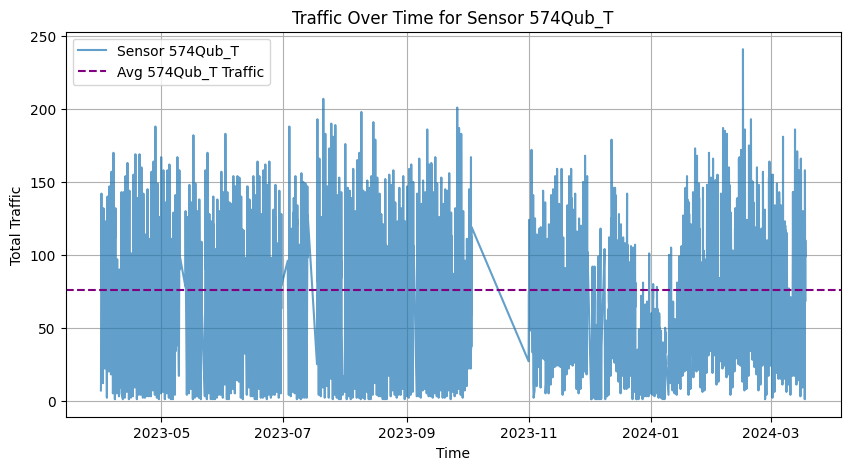

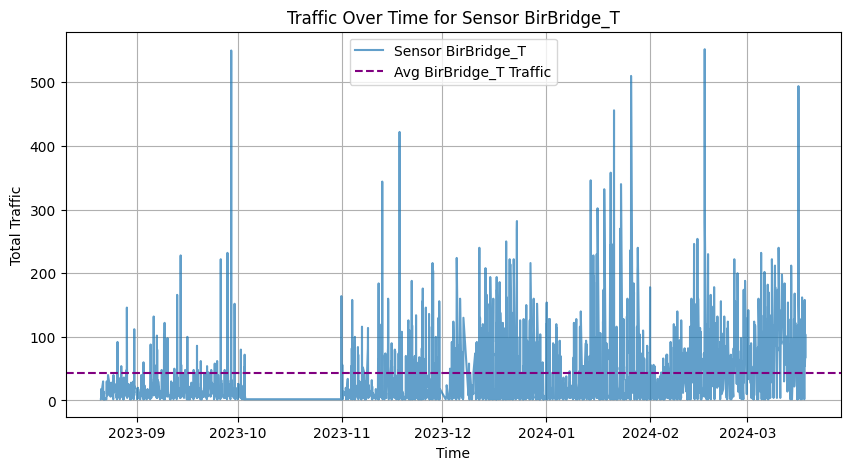

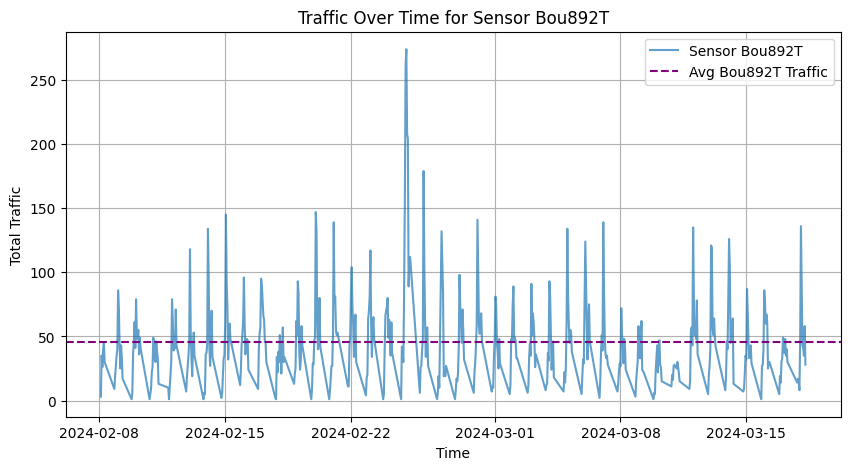

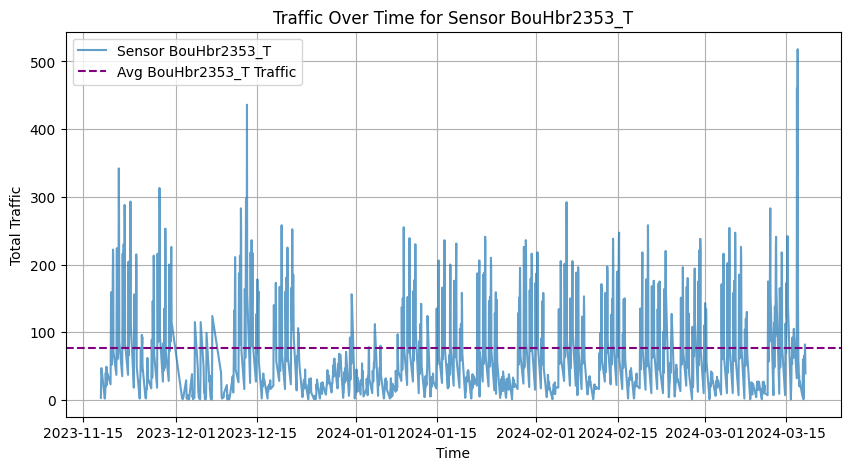

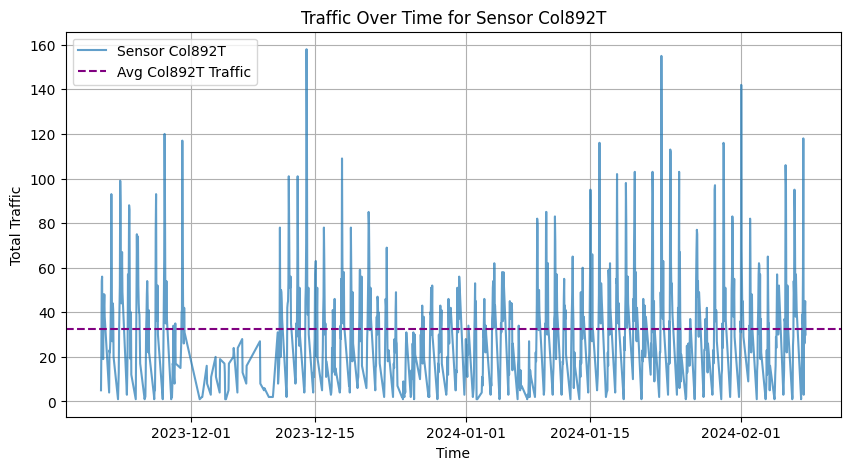

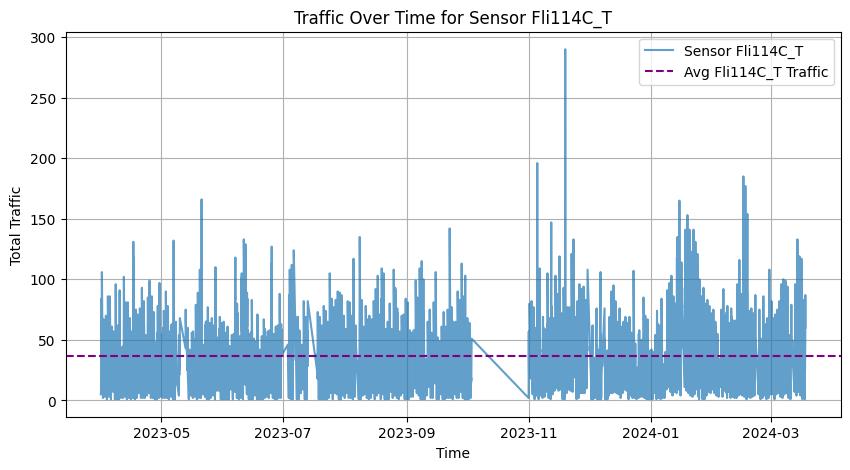

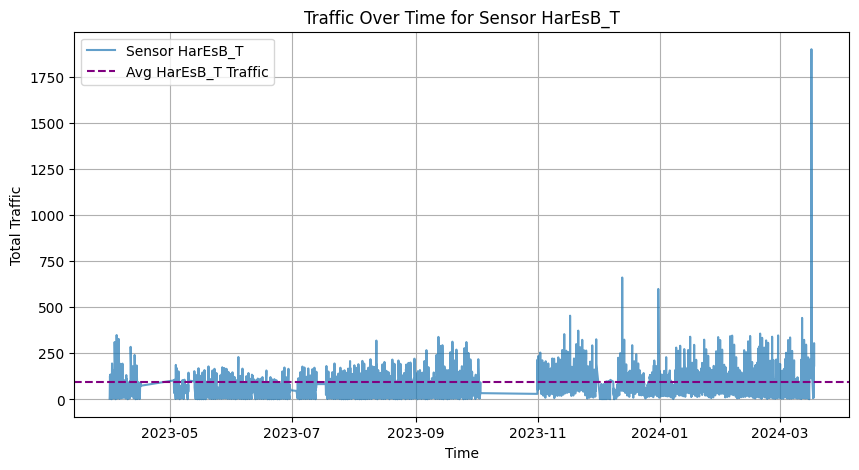

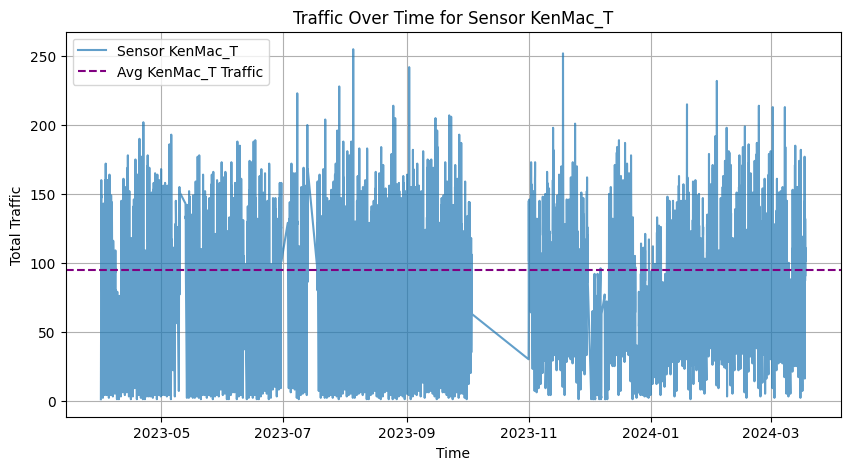

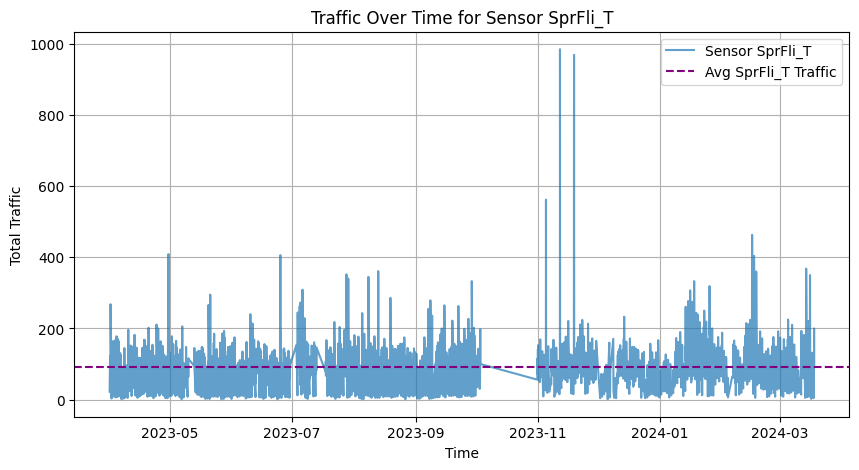

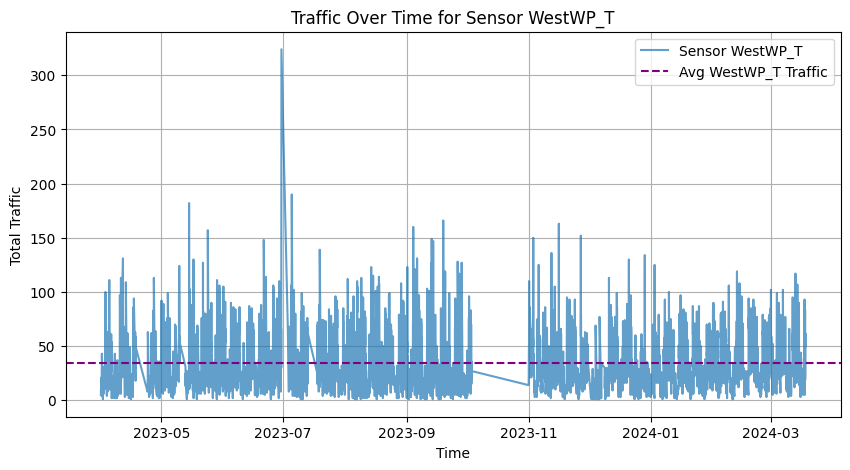

In [53]:
# Graph
for sensor_name in low_traffic_sensors.index:
    specific_sensor_data = nighttime_data[nighttime_data['sensor_name'] == sensor_name]
    specific_sensor_data = specific_sensor_data.groupby('timestamp')['total_of_directions'].sum()
    plt.figure(figsize=(10, 5))
    plt.plot(specific_sensor_data.index, specific_sensor_data.values, label=f'Sensor {sensor_name}', alpha=0.7)
    plt.axhline(specific_sensor_data.mean(), linestyle='--', color = 'purple', label=f'Avg {sensor_name} Traffic')
    plt.title(f'Traffic Over Time for Sensor {sensor_name}')
    plt.xlabel('Time')
    plt.ylabel('Total Traffic')
    plt.legend()
    plt.grid(True)
    plt.show()

In [54]:
mean_traffic_per_sensor = grouped_data.mean(axis=0)  # Calculate rows
# Find top 5 locations
top_sensors = mean_traffic_per_sensor.sort_values(ascending=False).head(5)
print("NightTime Top 5 Traffic Areas:")
print(top_sensors)

NightTime Top 5 Traffic Areas:
sensor_name
Swa31       2301.448130
Swa123_T    2053.774108
ElFi_T      1544.865905
Bou292_T    1518.792428
PriNW_T     1508.672513
dtype: float64


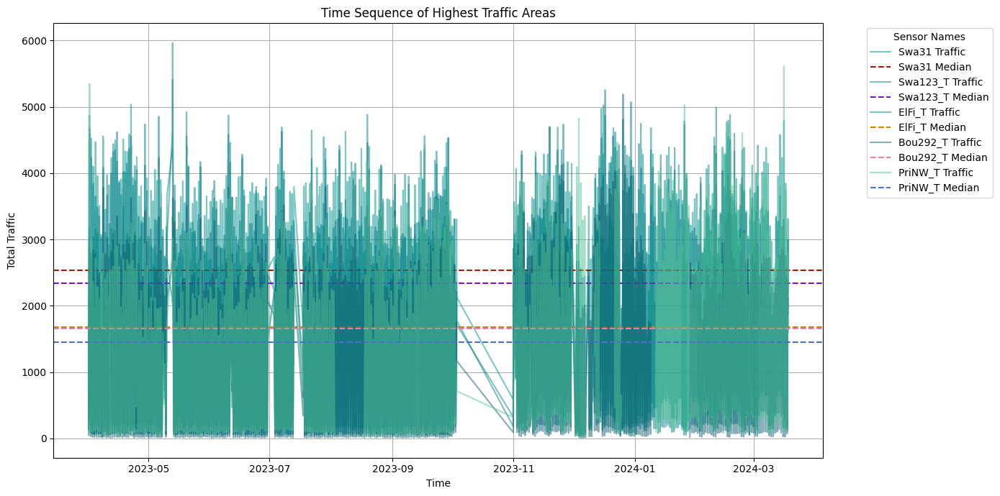

In [55]:
# # Highest Traffic Areas
color_primary = color_d_extend

plt.figure(figsize=(14, 7))
color_primary_extended = color_primary * (len(top_sensors.index) // len(color_primary) + 1)
color_median_extended = color_median * (len(top_sensors.index) // len(color_median) + 1)

for sensor, color, color_med in zip(top_sensors.index, color_primary_extended, color_median_extended):
    # Plot sensor
    plt.plot(grouped_data.index, grouped_data[sensor], label=f'{sensor} Traffic', color=color, alpha=0.5)

    # Calculate median
    median_traffic = grouped_data[sensor].median()
    plt.axhline(y=median_traffic, color=color_med, linestyle='--', label=f'{sensor} Median')

plt.title('Time Sequence of Highest Traffic Areas')
plt.xlabel('Time')
plt.ylabel('Total Traffic')
plt.legend(title='Sensor Names', loc='upper left', bbox_to_anchor=(1.05, 1))
plt.grid(True)
plt.tight_layout()
plt.show()


In [56]:
# Find location for PM
def extract_lat_lon(location):
    lat, lon = location.split(', ')
    return float(lat), float(lon)

nighttime_data['latitude'], nighttime_data['longitude'] = zip(*nighttime_data['location_x'].apply(extract_lat_lon))
grouped_data = nighttime_data.groupby(['sensor_name', 'timestamp'])['total_of_directions'].sum().unstack(0)
mean_traffic_per_sensor = grouped_data.mean(axis=0)

# Find top 5 locations
top_sensors = mean_traffic_per_sensor.sort_values(ascending=False).head(5)
nighttime_map = folium.Map(location=[nighttime_data['latitude'].mean(), nighttime_data['longitude'].mean()], zoom_start=15)
for sensor in top_sensors.index:
    lat = nighttime_data.loc[nighttime_data['sensor_name'] == sensor, 'latitude'].iloc[0]
    lon = nighttime_data.loc[nighttime_data['sensor_name'] == sensor, 'longitude'].iloc[0]
    traffic = top_sensors[sensor]
    folium.Marker(location=[lat, lon], popup=f"Sensor: {sensor}\nTraffic: {traffic}").add_to(nighttime_map)

nighttime_map

In [57]:
# Find lowest 5 locations
lowest_sensors = mean_traffic_per_sensor.sort_values(ascending=True).head(5)
print("NightTime Top 5 Traffic Areas:")
print(lowest_sensors)

NightTime Top 5 Traffic Areas:
sensor_name
Col892T        32.661238
WestWP_T       34.361893
Fli114C_T      37.036960
BirBridge_T    42.898846
Bou892T        45.663900
dtype: float64


### Outliers in dataset
- Replaced outliers with mean

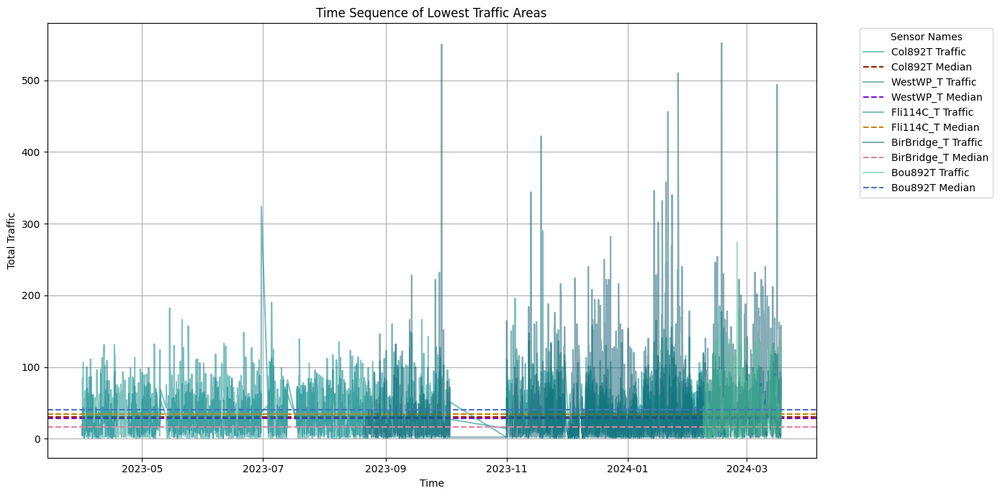

In [58]:
# # Highest Traffic Areas
color_primary = color_d_extend

plt.figure(figsize=(14, 7))
color_primary_extended = color_primary * (len(lowest_sensors.index) // len(color_primary) + 1)
color_median_extended = color_median * (len(lowest_sensors.index) // len(color_median) + 1)

for sensor, color, color_med in zip(lowest_sensors.index, color_primary_extended, color_median_extended):
    # Plot sensor
    plt.plot(grouped_data.index, grouped_data[sensor], label=f'{sensor} Traffic', color=color, alpha=0.5)

    # Calculate median
    median_traffic = grouped_data[sensor].median()
    plt.axhline(y=median_traffic, color=color_med, linestyle='--', label=f'{sensor} Median')

plt.title('Time Sequence of Lowest Traffic Areas')
plt.xlabel('Time')
plt.ylabel('Total Traffic')
plt.legend(title='Sensor Names', loc='upper left', bbox_to_anchor=(1.05, 1))
plt.grid(True)
plt.tight_layout()
plt.show()

In [59]:
# Find lowest 5 locations
lowest_sensors = mean_traffic_per_sensor.sort_values(ascending=True).head(5)
nighttime_map = folium.Map(location=[nighttime_data['latitude'].mean(), nighttime_data['longitude'].mean()], zoom_start=15)
for sensor in lowest_sensors.index:
    lat = nighttime_data.loc[nighttime_data['sensor_name'] == sensor, 'latitude'].iloc[0]
    lon = nighttime_data.loc[nighttime_data['sensor_name'] == sensor, 'longitude'].iloc[0]
    traffic = lowest_sensors[sensor]
    folium.Marker(location=[lat, lon], popup=f"Sensor: {sensor}\nTraffic: {traffic}").add_to(nighttime_map)

nighttime_map

In [63]:
nighttime_data.head()

,sensor_name,timestamp,locationid,direction_1_x,direction_2_x,total_of_directions,location_x,location_id,sensor_description,installation_date,note,location_type,status,direction_1_y,direction_2_y,latitude,longitude,location_y,hour
3,Lat224_T,2023-05-02 20:00:00+00:00,62,50,27,77,"-37.80996494, 144.96216521",62.0,La Trobe St (North),2019-09-25,NaN,Outdoor,A,East,West,-37.809965,144.962165,"-37.80996494, 144.96216521",20
4,Lat224_T,2023-05-02 21:00:00+00:00,62,61,42,103,"-37.80996494, 144.96216521",62.0,La Trobe St (North),2019-09-25,NaN,Outdoor,A,East,West,-37.809965,144.962165,"-37.80996494, 144.96216521",21
5,Lat224_T,2023-05-02 23:00:00+00:00,62,106,79,185,"-37.80996494, 144.96216521",62.0,La Trobe St (North),2019-09-25,NaN,Outdoor,A,East,West,-37.809965,144.962165,"-37.80996494, 144.96216521",23
6,Lat224_T,2023-05-03 02:00:00+00:00,62,211,147,358,"-37.80996494, 144.96216521",62.0,La Trobe St (North),2019-09-25,NaN,Outdoor,A,East,West,-37.809965,144.962165,"-37.80996494, 144.96216521",2
7,Lat224_T,2023-05-03 03:00:00+00:00,62,191,108,299,"-37.80996494, 144.96216521",62.0,La Trobe St (North),2019-09-25,NaN,Outdoor,A,East,West,-37.809965,144.962165,"-37.80996494, 144.96216521",3


# Identify peak activity times
- Find the hour(s) with the highest total activity, and then print and visualize the peak activity times.

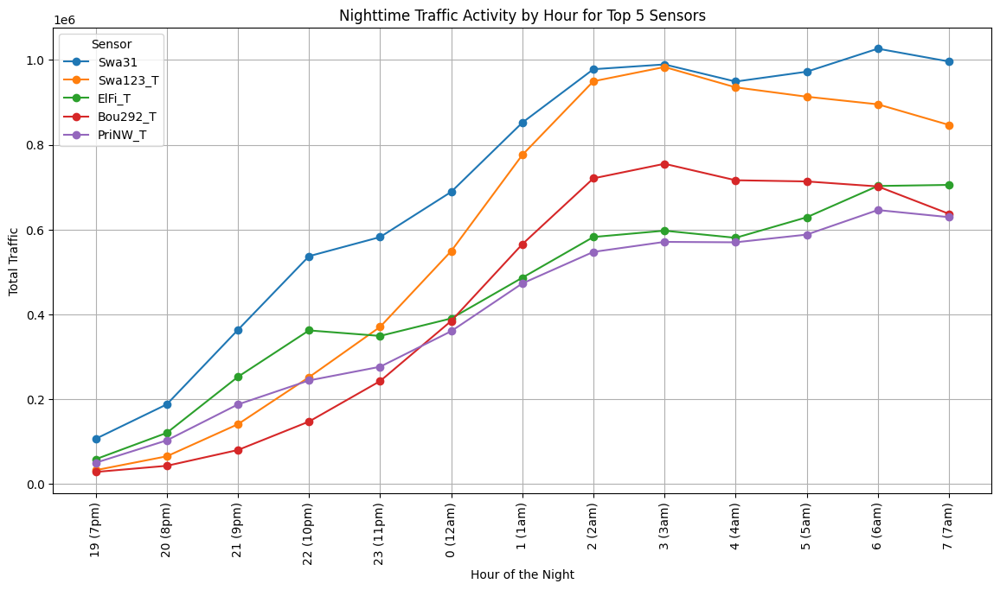

In [64]:
# Plot top sensor locations heighest traffic
top_sensors_data = nighttime_data[nighttime_data['sensor_name'].isin(top_sensors.index)]
activity_by_sensor_and_hour = top_sensors_data.groupby(['sensor_name', 'hour'])['total_of_directions'].sum()
ordered_hours = list(range(19, 24)) + list(range(0, 8))
labels = [f"{h} ({(h if h < 12 else h-12) or 12}{'am' if h < 12 else 'pm'})" for h in ordered_hours]

plt.figure(figsize=(14, 7))
for sensor in top_sensors.index:
    hourly_data = activity_by_sensor_and_hour.loc[sensor].reindex(ordered_hours, fill_value=0)
    plt.plot(labels, hourly_data, marker='o', label=f"{sensor}")

plt.title('Nighttime Traffic Activity by Hour for Top 5 Sensors')
plt.xlabel('Hour of the Night')
plt.ylabel('Total Traffic')
plt.xticks(rotation=90)  # Rotate labels for better readability
plt.legend(title='Sensor')
plt.grid(True)
plt.show()

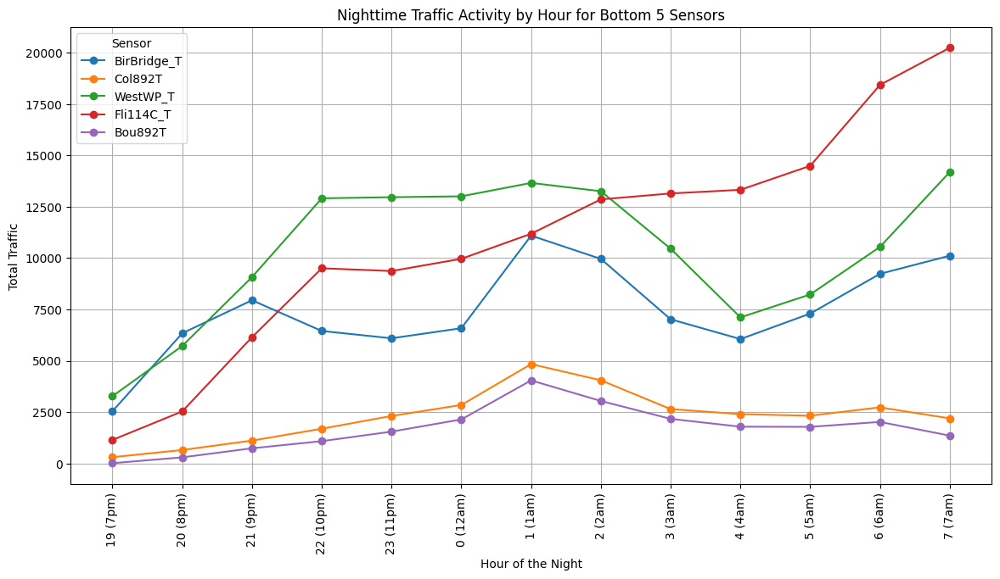

In [65]:
# Plot top sensor locations lowest traffic
bottom_sensors = mean_traffic_per_sensor.nsmallest(5)
bottom_sensors_data = nighttime_data[nighttime_data['sensor_name'].isin(bottom_sensors.index)]
activity_by_sensor_and_hour = bottom_sensors_data.groupby(['sensor_name', 'hour'])['total_of_directions'].sum()
ordered_hours = list(range(19, 24)) + list(range(0, 8))
labels = [f"{h} ({(h if h < 12 else h-12) or 12}{'am' if h < 12 else 'pm'})" for h in ordered_hours]

plt.figure(figsize=(14, 7))
for sensor in bottom_sensors.index:
    hourly_data = activity_by_sensor_and_hour.loc[sensor].reindex(ordered_hours, fill_value=0)
    plt.plot(labels, hourly_data, marker='o', label=f"{sensor}")

plt.title('Nighttime Traffic Activity by Hour for Bottom 5 Sensors')
plt.xlabel('Hour of the Night')
plt.ylabel('Total Traffic')
plt.xticks(rotation=90)
plt.legend(title='Sensor')
plt.grid(True)
plt.show()


# Identify correlation between Traffic Sensors and Parking Data
- User can find nearby parking options
- Haversine formula

### User interface - Locate nearest parking

In [68]:
# Find nearest parking location
def haversine(lat1, lon1, lat2, lon2):
    lat1, lon1, lat2, lon2 = np.radians([lat1, lon1, lat2, lon2])
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = np.sin(dlat / 2) ** 2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon / 2) ** 2
    c = 2 * np.arcsin(np.sqrt(a))
    R = 6371.0  # Earth radius in kilometers
    distance_meters = R * c * 1000  # Convert to meters
    return distance_meters

# Nearest parking spot
def find_nearest_parking_sensor(traffic_sensor_location, parking_data):
    min_distance = float('inf')
    nearest_sensor = None

    for index, row in parking_data.iterrows():
        parking_lat = row['latitude']
        parking_lon = row['longitude']
        distance = haversine(traffic_sensor_location[0], traffic_sensor_location[1], parking_lat, parking_lon)
        if distance < min_distance:
            min_distance = distance
            nearest_sensor = row

    print(f"Distance to nearest parking sensor: {min_distance:.2f} meters")
    return nearest_sensor

# User input
lat = float(input("Enter latitude for the traffic sensor location: "))
lon = float(input("Enter longitude for the traffic sensor location: "))
traffic_sensor_location = (lat, lon)
nearest_parking_sensor = find_nearest_parking_sensor(traffic_sensor_location, on_street_parking)
print(nearest_parking_sensor)

# Example
# latitude                                                         -37.836245
# longitude                                                        144.982021

Enter latitude for the traffic sensor location: -37.836245
Enter longitude for the traffic sensor location: 144.982021
Distance to nearest parking sensor: 0.05 meters
roadsegmentid                                                         22730
roadsegmentdescription    Park Street between Mason Street and Randall P...
latitude                                                         -37.836245
longitude                                                        144.982021
lastupdated                                                      2022-08-31
Name: 15026, dtype: object


'\nlatitude                                                         -37.836245\nlongitude                                                        144.982021\n'

In [69]:
# Find Parking for 5 traffic areas
for sensor in top_sensors.index:
    traffic_sensor_location = (nighttime_data.loc[nighttime_data['sensor_name'] == sensor, 'latitude'].iloc[0],
                               nighttime_data.loc[nighttime_data['sensor_name'] == sensor, 'longitude'].iloc[0])

    nearest_parking_sensor = find_nearest_parking_sensor(traffic_sensor_location, on_street_parking)
    distance = haversine(traffic_sensor_location[0], traffic_sensor_location[1],
                         nearest_parking_sensor['latitude'], nearest_parking_sensor['longitude'])

    print(f"Distance from traffic sensor {sensor} to nearest parking sensor: {distance} meters")

Distance to nearest parking sensor: 22.89 meters
Distance from traffic sensor Swa31 to nearest parking sensor: 22.88627125361435 meters
Distance to nearest parking sensor: 38.35 meters
Distance from traffic sensor Swa123_T to nearest parking sensor: 38.351252140340954 meters
Distance to nearest parking sensor: 13.88 meters
Distance from traffic sensor ElFi_T to nearest parking sensor: 13.883197942752169 meters
Distance to nearest parking sensor: 97.73 meters
Distance from traffic sensor Bou292_T to nearest parking sensor: 97.73196675195793 meters
Distance to nearest parking sensor: 162.78 meters
Distance from traffic sensor PriNW_T to nearest parking sensor: 162.7780944031611 meters


### Part 2

###### Spatial Analysis:

Map the pedestrian counts onto the city's pedestrian network to identify high and low traffic areas.
Use machine learning clustering techniques to identify hotspots of night activity.

In [70]:
nighttime_data.dtypes

sensor_name                         object
timestamp              datetime64[ns, UTC]
locationid                           int64
direction_1_x                        int64
direction_2_x                        int64
total_of_directions                  int64
location_x                          object
location_id                        float64
sensor_description                  object
installation_date                   object
note                                object
location_type                       object
status                              object
direction_1_y                       object
direction_2_y                       object
latitude                           float64
longitude                          float64
location_y                          object
hour                                 int32
dtype: object

In [71]:
pedestrian_network.dtypes

geo_point_2d    object
geo_shape       object
objectid         int64
lat             object
lon             object
dtype: object

In [72]:
business_establishments.dtypes

census_year                       int64
block_id                          int64
property_id                       int64
base_property_id                  int64
clue_small_area                  object
trading_name                     object
business_address                 object
industry_anzsic4_code             int64
industry_anzsic4_description     object
longitude                       float64
latitude                        float64
dtype: object

### Created GeoDataFrames
- Pedestrian network
- nightime_data (combined PM filtered data)

In [73]:
# GeoDataFrames
pedestrian_network['lat'] = pd.to_numeric(pedestrian_network['lat'], errors='coerce')
pedestrian_network['lon'] = pd.to_numeric(pedestrian_network['lon'], errors='coerce')
pedestrian_network = pedestrian_network.dropna(subset=['lat', 'lon'])

pedestrian_network_gdf = gpd.GeoDataFrame(pedestrian_network,
                                           geometry=gpd.points_from_xy(pedestrian_network['lon'],
                                                                       pedestrian_network['lat']),
                                           crs="EPSG:4326")

nighttime_data_gdf = gpd.GeoDataFrame(nighttime_data,
                                      geometry=gpd.points_from_xy(nighttime_data['longitude'],
                                                                  nighttime_data['latitude']),
                                      crs="EPSG:4326")


In [74]:
print("pedestrian_network_gdf head:")
print(pedestrian_network_gdf.head())
print("\nnighttime_data_gdf head:")
print(nighttime_data_gdf.head())

pedestrian_network_gdf head:
                          geo_point_2d  \
0  -37.791128630450004, 144.9250621319   
1    -37.790885197, 144.92478186034998   
2  -37.79063325525, 144.92244485650002   
3  -37.790601697949995, 144.9253671047   
4         -37.790968201, 144.942393422   

                                           geo_shape  objectid        lat  \
0  {"coordinates": [[144.9251354935, -37.79109699...      5735 -37.791129   
1  {"coordinates": [[144.9247703611, -37.79089170...      5738 -37.790885   
2  {"coordinates": [[144.9224965319, -37.79068385...      5740 -37.790633   
3  {"coordinates": [[144.9254894579, -37.79073841...      5743 -37.790602   
4  {"coordinates": [[144.9424411919, -37.79097389...      5744 -37.790968   

          lon                     geometry  
0  144.925062  POINT (144.92506 -37.79113)  
1  144.924782  POINT (144.92478 -37.79089)  
2  144.922445  POINT (144.92244 -37.79063)  
3  144.925367  POINT (144.92537 -37.79060)  
4  144.942393  POINT (144.9423

In [75]:
# Combine two GeoDataFrames
combined_gdf = gpd.GeoDataFrame(pd.concat([pedestrian_network_gdf, nighttime_data_gdf], ignore_index=True),
                                 crs="EPSG:4326")
print(combined_gdf.info())

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 395582 entries, 0 to 395581
Data columns (total 25 columns):
 #   Column               Non-Null Count   Dtype              
---  ------               --------------   -----              
 0   geo_point_2d         85326 non-null   object             
 1   geo_shape            85326 non-null   object             
 2   objectid             85326 non-null   float64            
 3   lat                  85326 non-null   float64            
 4   lon                  85326 non-null   float64            
 5   geometry             395582 non-null  geometry           
 6   sensor_name          310256 non-null  object             
 7   timestamp            310256 non-null  datetime64[ns, UTC]
 8   locationid           310256 non-null  float64            
 9   direction_1_x        310256 non-null  float64            
 10  direction_2_x        310256 non-null  float64            
 11  total_of_directions  310256 non-null  float64            

###### Trend Analysis:
- Yearly analysis to identify trends in nighttime foot traffic.
1. Find trends in the count of sensor data points over different years

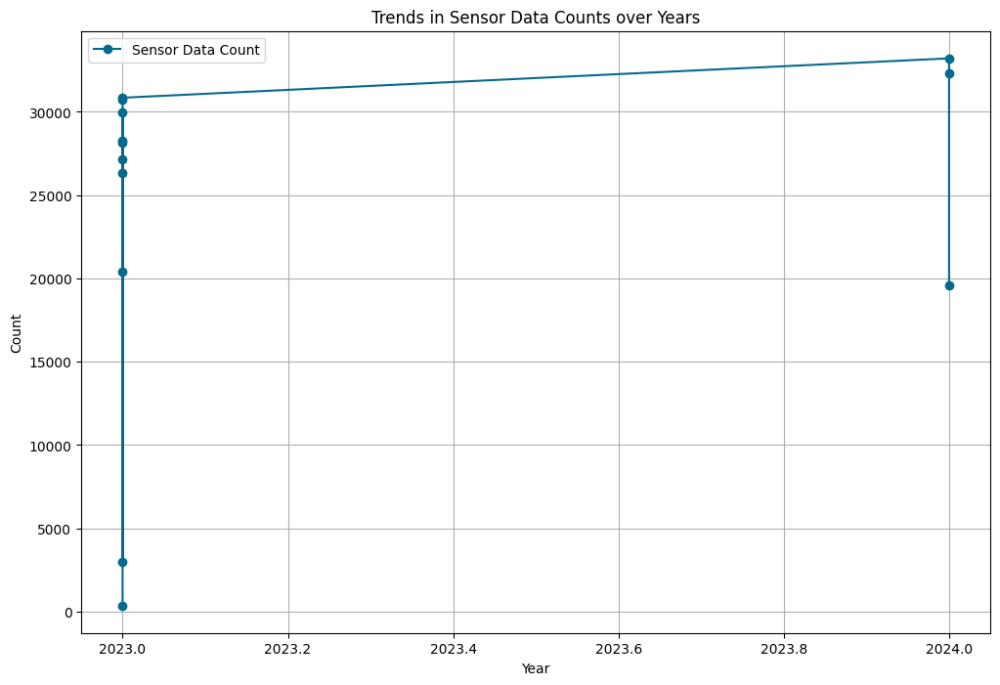

In [76]:
# Find sensor yearly trends
combined_gdf['timestamp'] = pd.to_datetime(combined_gdf['timestamp'])
combined_gdf['month'] = combined_gdf['timestamp'].dt.month
combined_gdf['year'] = combined_gdf['timestamp'].dt.year

# Month vs Year
sensor_trends = combined_gdf.groupby(['year', 'month']).agg({
    'sensor_name': 'count',  # Counting the number of sensor data points
    'direction_1_x': 'mean', # Average of direction 1
    'direction_2_x': 'mean', # Average of direction 2
    'total_of_directions': 'sum' # Total directions
}).reset_index()

plt.figure(figsize=(12, 8))
plt.plot(sensor_trends['year'], sensor_trends['sensor_name'], marker='o', linestyle='-', label='Sensor Data Count', color=color_d[3])
plt.xlabel('Year')
plt.ylabel('Count')
plt.title('Trends in Sensor Data Counts over Years')
plt.legend()
plt.grid(True)
plt.show()

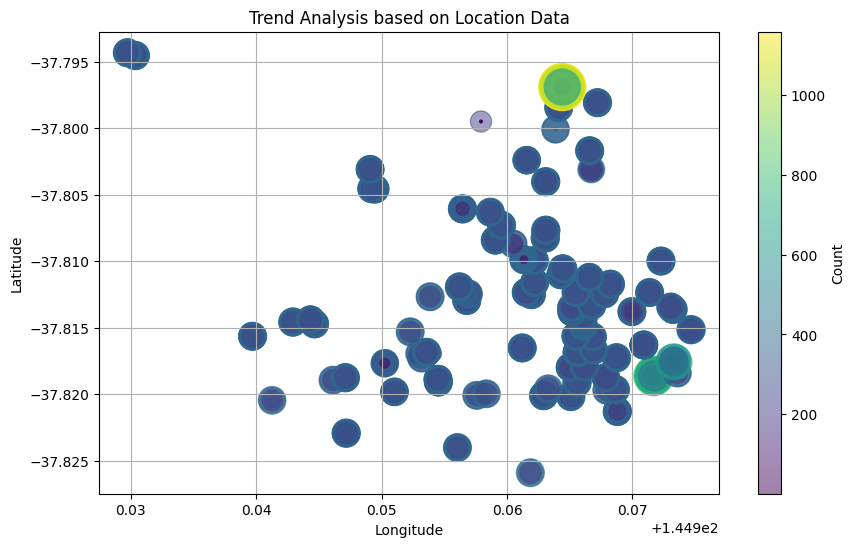

In [77]:
# Find location data based on year/ month (Lat and long & aggregate)
location_data = combined_gdf.groupby(['latitude', 'longitude', 'year', 'month']).size().reset_index(name='count')
plt.figure(figsize=(10, 6))
plt.scatter(location_data['longitude'], location_data['latitude'], s=location_data['count'], c=location_data['count'], cmap='viridis', alpha=0.5)
plt.colorbar(label='Count')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Trend Analysis based on Location Data')
plt.grid(True)
plt.show()

In [78]:
location_data.head()

,latitude,longitude,year,month,count
0,-37.825910,144.961860,2023.0,12.0,286
1,-37.825910,144.961860,2024.0,1.0,403
2,-37.825910,144.961860,2024.0,2.0,375
3,-37.825910,144.961860,2024.0,3.0,219
4,-37.824018,144.956044,2023.0,8.0,187


### Find Traffic Data based on Year and Month

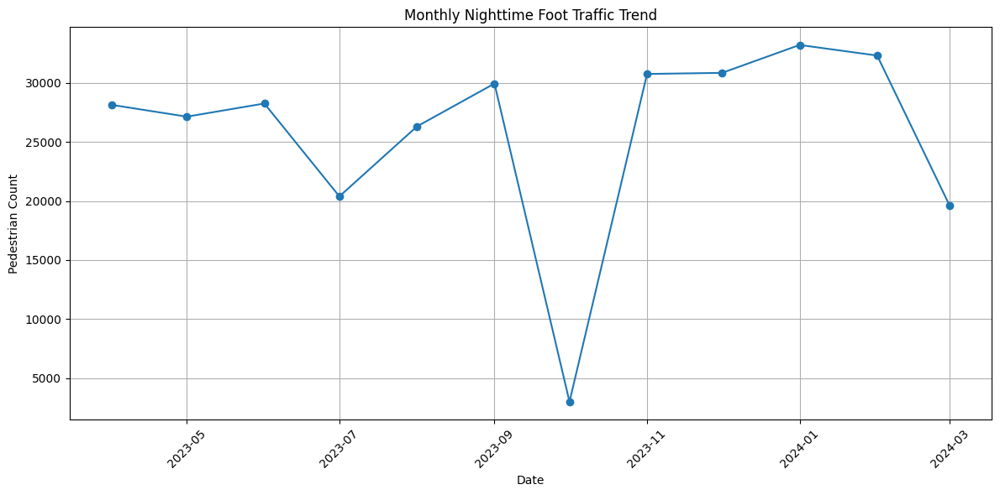

,year,month,count,date
0,2023.0,4.0,28137,2023-04-01
1,2023.0,5.0,27140,2023-05-01
2,2023.0,6.0,28254,2023-06-01
3,2023.0,7.0,20386,2023-07-01
4,2023.0,8.0,26308,2023-08-01
5,2023.0,9.0,29944,2023-09-01
6,2023.0,10.0,2992,2023-10-01
7,2023.0,11.0,30757,2023-11-01
8,2023.0,12.0,30850,2023-12-01
9,2024.0,1.0,33213,2024-01-01


,year,count
0,2023.0,224768
1,2024.0,85127


In [79]:
import pandas as pd
import matplotlib.pyplot as plt

# Collection started 2023 (03) thus remove 03 month as skews data
location_data = location_data[~((location_data['year'] == 2023) & (location_data['month'] == 3.0))]
monthly_traffic = location_data.groupby(['year', 'month']).agg({'count': 'sum'}).reset_index()
monthly_traffic['date'] = pd.to_datetime(monthly_traffic[['year', 'month']].assign(day=1))
yearly_traffic = location_data.groupby('year').agg({'count': 'sum'}).reset_index()

# Month
plt.figure(figsize=(12, 6))
plt.plot(monthly_traffic['date'], monthly_traffic['count'], marker='o')
plt.title('Monthly Nighttime Foot Traffic Trend')
plt.xlabel('Date')
plt.ylabel('Pedestrian Count')
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# data
display(monthly_traffic)
display(yearly_traffic)

In [82]:
# map
map_center = [combined_gdf['latitude'].mean(), combined_gdf['longitude'].mean()]
mymap = folium.Map(location=map_center, zoom_start=15)

# Traffic colours
blue_shades = {
    0: '#deebf7',    # Low traffic
    300: '#9ecae1',  # Moderate traffic
    800: '#3182bd',  # High traffic
    'max': '#08519c' # Highest traffic
}

# Map Markers
for index, row in location_data.iterrows():
    if row['count'] < 300:
        color = blue_shades[0]
    elif 300 <= row['count'] < 800:
        color = blue_shades[300]
    else:
        color = blue_shades[800]

    # Traffic intensity
    radius = 5 + 45 * (row['count'] / location_data['count'].max())
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=radius,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        popup=f"Count: {row['count']}"
    ).add_to(mymap)

mymap

In [81]:
on_street_parking.head()

,roadsegmentid,roadsegmentdescription,latitude,longitude,lastupdated
0,20751,Argyle Place South between Lygon Street and Ca...,-37.803448,144.965682,2023-05-28
1,20751,Argyle Place South between Lygon Street and Ca...,-37.803428,144.965496,2023-05-28
2,20751,Argyle Place South between Lygon Street and Ca...,-37.803413,144.965361,2023-05-28
3,22499,Queensberry Street between Lygon Street and Ca...,-37.804688,144.965314,2023-05-28
4,22499,Queensberry Street between Lygon Street and Ca...,-37.804695,144.965379,2023-05-28


### User Interface: Find nearby parks based on sensor selected
- GeoDataFrame
- KDTree for fast nearest neighbor search

In [ ]:
# User interface
# GeoDataFrame
on_street_parking_gdf = gpd.GeoDataFrame(
    on_street_parking,
    geometry=gpd.points_from_xy(on_street_parking.longitude, on_street_parking.latitude)
)

nighttime_data_gdf['geometry'] = gpd.points_from_xy(nighttime_data_gdf.longitude, nighttime_data_gdf.latitude)

# KDTree
parking_tree = cKDTree(on_street_parking_gdf[['longitude', 'latitude']])
sensor_tree = cKDTree(nighttime_data_gdf[['longitude', 'latitude']])
sensor_dropdown = Dropdown(options=nighttime_data_gdf['sensor_description'])

def plot_nearest_parking(sensor_description):
    selected_sensor = nighttime_data_gdf[nighttime_data_gdf['sensor_description'] == sensor_description].iloc[0]
    selected_sensor_location = (selected_sensor['longitude'], selected_sensor['latitude'])
    _, nearest_parking_indices = parking_tree.query(selected_sensor_location, k=5)
    m = folium.Map(location=[selected_sensor['latitude'], selected_sensor['longitude']], zoom_start=15)

    # Marker Location
    folium.Marker(
        location=[selected_sensor['latitude'], selected_sensor['longitude']],
        popup=f"Sensor: {sensor_description}",
        icon=folium.Icon(color='blue')
    ).add_to(m)

    # Markers Parking
    for idx in nearest_parking_indices:
        parking_location = on_street_parking_gdf.iloc[idx]
        folium.Marker(
            location=[parking_location['latitude'], parking_location['longitude']],
            popup=f"Parking: {parking_location['roadsegmentdescription']}",
            icon=folium.Icon(color='green')
        ).add_to(m)

    display(m)
interact(plot_nearest_parking, sensor_description=sensor_dropdown)

interactive(children=(Dropdown(description='sensor_description', options=('Spring St- Flinders st (West)', 'Sp…

<function __main__.plot_nearest_parking(sensor_description)>

# Find businesses that are located in same area as top traffic sensors
- Find locations of the top sensors
- Filter heaviest traffic times for these sensors
- Identify businesses located near each top sensor
- Filter businesses based on times for peak traffic

## Review business types
- Filter locations where business would benefit
```
Locations = [
    'Takeaway Food Services',
    'Entertainment Media Retailing',
    'Cafes and Restaurants',
    'Newspaper and Book Retailing',
    'Footwear Retailing',
    'Health and Fitness Centres and Gymnasia Operation',
    'Mens Clothing Retailing',
    'Womens Clothing Retailing',
    'Clothing Retailing',
    'Childrens Clothing Retailing',
    'Watch and Jewellery Retailing',
    'Hairdressing and Beauty Services',
    'Travel Agency and Tour Arrangement Services',
    'Flower Retailing',
    'Architectural Services',
    'Sport and Camping Equipment Retailing',
    'Pubs, Taverns, and Bars',
    'Mens Footwear Retailing',
    'Antique and Used Goods Retailing',
    'Department Stores',
    'Video and Other Electronic Media Rental',
    'Supermarket and Grocery Stores',
    'Liquor Retailing'
]
```






In [83]:
business_establishments.head()

,census_year,block_id,property_id,base_property_id,clue_small_area,trading_name,business_address,industry_anzsic4_code,industry_anzsic4_description,longitude,latitude
0,2004,44,108110,108110,Melbourne (CBD),Total Tel International,"Part Level 12, 140-0 Queen Street MELBOURNE 3000",5809,Other Telecommunications Services,144.961185,-37.815391
1,2004,44,108110,108110,Melbourne (CBD),CJ Ham & Murray,"Part Floor 2, 140 Queen Street MELBOURNE 3000",6720,Real Estate Services,144.961185,-37.815391
2,2004,44,108111,108111,Melbourne (CBD),Netherlands Consulate,"Suite 7, Part Level 4, 118-126 Queen Street ME...",7552,Foreign Government Representation,144.961308,-37.815656
3,2004,44,108111,108111,Melbourne (CBD),Thomas Koutsoupias,"Suite 10, Level 9, 118-126 Queen Street MELBOU...",6931,Legal Services,144.961308,-37.815656
4,2004,44,108111,108111,Melbourne (CBD),K S T Partners,"Suite 4, Floor 5, 118 Queen Street MELBOURNE 3000",6932,Accounting Services,144.961308,-37.815656


In [91]:
unique_records = business_establishments['industry_anzsic4_description'].unique()
print(unique_records)

['Other Telecommunications Services' 'Real Estate Services'
 'Foreign Government Representation' 'Legal Services'
 'Accounting Services' 'Alternative Health Services'
 'Office Administrative Services'
 'Computer System Design and Related Services'
 'Newspaper and Book Retailing' 'Other Specialised Design Services'
 'Houseware Retailing' 'Footwear Retailing' 'Health Insurance'
 'Health and Fitness Centres and Gymnasia Operation'
 'Technical and Vocational Education and Training'
 'Other Manufacturing n.e.c.' 'Other Interest Group Services n.e.c.'
 'Vacant Space' 'Hairdressing and Beauty Services'
 'Takeaway Food Services' 'Entertainment Media Retailing'
 'Pharmaceutical, Cosmetic and Toiletry Goods Retailing'
 'Mens Clothing Retailing' 'Cafes and Restaurants'
 'Womens Clothing Retailing' 'Clothing Retailing'
 'Childrens Clothing Retailing' 'Accommodation'
 'Watch and Jewellery Retailing' 'Other Repair and Maintenance n.e.c.'
 'Other Specialised Food Retailing'
 'Travel Agency and Tour A

In [92]:
locations = [
    'Takeaway Food Services',
    'Entertainment Media Retailing',
    'Cafes and Restaurants',
    'Newspaper and Book Retailing',
    'Footwear Retailing',
    'Health and Fitness Centres and Gymnasia Operation',
    'Mens Clothing Retailing',
    'Womens Clothing Retailing',
    'Clothing Retailing',
    'Childrens Clothing Retailing',
    'Watch and Jewellery Retailing',
    'Hairdressing and Beauty Services',
    'Travel Agency and Tour Arrangement Services',
    'Flower Retailing',
    'Architectural Services',
    'Sport and Camping Equipment Retailing',
    'Pubs, Taverns, and Bars',
    'Mens Footwear Retailing',
    'Antique and Used Goods Retailing',
    'Department Stores',
    'Video and Other Electronic Media Rental',
    'Supermarket and Grocery Stores',
    'Liquor Retailing'
]

filtered_business_establishments = business_establishments[business_establishments['industry_anzsic4_description'].isin(locations)]


In [85]:
nighttime_data_gdf.head()

,sensor_name,timestamp,locationid,direction_1_x,direction_2_x,total_of_directions,location_x,location_id,sensor_description,installation_date,note,location_type,status,direction_1_y,direction_2_y,latitude,longitude,location_y,hour,geometry
3,Lat224_T,2023-05-02 20:00:00+00:00,62,50,27,77,"-37.80996494, 144.96216521",62.0,La Trobe St (North),2019-09-25,NaN,Outdoor,A,East,West,-37.809965,144.962165,"-37.80996494, 144.96216521",20,POINT (144.96217 -37.80996)
4,Lat224_T,2023-05-02 21:00:00+00:00,62,61,42,103,"-37.80996494, 144.96216521",62.0,La Trobe St (North),2019-09-25,NaN,Outdoor,A,East,West,-37.809965,144.962165,"-37.80996494, 144.96216521",21,POINT (144.96217 -37.80996)
5,Lat224_T,2023-05-02 23:00:00+00:00,62,106,79,185,"-37.80996494, 144.96216521",62.0,La Trobe St (North),2019-09-25,NaN,Outdoor,A,East,West,-37.809965,144.962165,"-37.80996494, 144.96216521",23,POINT (144.96217 -37.80996)
6,Lat224_T,2023-05-03 02:00:00+00:00,62,211,147,358,"-37.80996494, 144.96216521",62.0,La Trobe St (North),2019-09-25,NaN,Outdoor,A,East,West,-37.809965,144.962165,"-37.80996494, 144.96216521",2,POINT (144.96217 -37.80996)
7,Lat224_T,2023-05-03 03:00:00+00:00,62,191,108,299,"-37.80996494, 144.96216521",62.0,La Trobe St (North),2019-09-25,NaN,Outdoor,A,East,West,-37.809965,144.962165,"-37.80996494, 144.96216521",3,POINT (144.96217 -37.80996)


### Review top Traffic areas and businesses - Recommendation that these businesses stay open during PM traffic
- Filter the traffic data for the time range 7 PM to 7 AM
- Calculate mean traffic for each sensor
- Identify top 5 traffic sensors
- Find businesses within a certain radius of each top sensor (100 meters)


In [99]:
# Find top 5 locations (traffic) and match businesses
nighttime_data['timestamp'] = pd.to_datetime(nighttime_data['timestamp'])
nighttime_data['hour'] = nighttime_data['timestamp'].dt.hour
filtered_traffic_data = nighttime_data[(nighttime_data['hour'] >= 19) | (nighttime_data['hour'] <= 7)]
mean_traffic_per_sensor = filtered_traffic_data.groupby('sensor_name')['total_of_directions'].mean()
top_sensors = mean_traffic_per_sensor.nlargest(5)

def find_nearby_businesses(sensor_name, radius=100):
    sensor_location = nighttime_data[nighttime_data['sensor_name'] == sensor_name].iloc[0]
    sensor_lat, sensor_lon = sensor_location['latitude'], sensor_location['longitude']
    filtered_business_establishments['distance'] = np.sqrt(
        (filtered_business_establishments['latitude'] - sensor_lat) ** 2 +
        (filtered_business_establishments['longitude'] - sensor_lon) ** 2) * 111000 # Meters

    # Businesses filter distance
    nearby_businesses = filtered_business_establishments[filtered_business_establishments['distance'] <= radius]
    return nearby_businesses[['trading_name', 'business_address', 'industry_anzsic4_description', 'distance']]

results = []
for sensor in top_sensors.index:
    nearby_businesses = find_nearby_businesses(sensor)
    for _, business in nearby_businesses.iterrows():
        results.append({
            'Sensor Name': sensor,
            'Business Name': business['trading_name'],
            'Address': business['business_address'],
            'Industry': business['industry_anzsic4_description'],
            'Distance (m)': business['distance']
        })

results_df = pd.DataFrame(results)
print(results_df)


     Sensor Name                Business Name  \
0          Swa31                    The Store   
1          Swa31         Lee Tan Beauty Salon   
2          Swa31                    Whitemoss   
3          Swa31               Max Stern & Co   
4          Swa31  Kim Sing Chinese Restaurant   
...          ...                          ...   
4533     PriNW_T                Riverland Bar   
4534     PriNW_T                      Pilgrim   
4535     PriNW_T            Popstic Ice Cream   
4536     PriNW_T            Popstic Ice Cream   
4537     PriNW_T            Popstic Ice Cream   

                                             Address  \
0           Shop 1, 237 Flinders Lane MELBOURNE 3000   
1                   9-0 Flinders Lane MELBOURNE 3000   
2           Shop 1, 241 Flinders Lane MELBOURNE 3000   
3           Shop 20,  Flinders Street MELBOURNE 3000   
4           Shop 10,  Flinders Street MELBOURNE 3000   
...                                              ...   
4533         Vault 

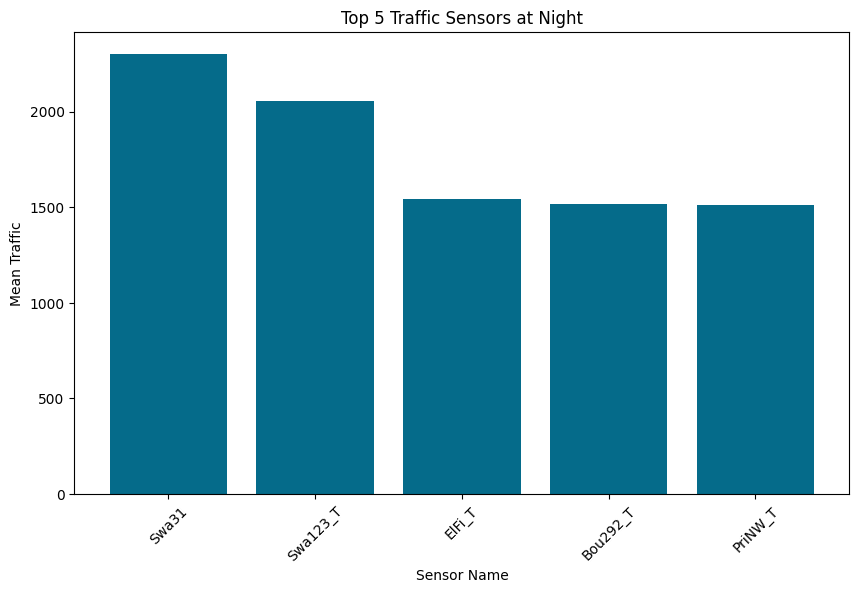

In [103]:
# Graph
plt.figure(figsize=(10, 6))
plt.bar(top_sensors.index, top_sensors.values, color=color_d[3])
plt.xlabel('Sensor Name')
plt.ylabel('Mean Traffic')
plt.title('Top 5 Traffic Sensors at Night')
plt.xticks(rotation=45)
plt.show()

In [123]:
# Find businesses correlate with top sensor
unique_business_names = results_df['Business Name'].unique()
print("Businesses within 100m Top Traffic Areas 6pm-6am:")
for name in unique_business_names:
    print(name)

Businesses within 100m Top Traffic Areas 6pm-6am:
The Store
Lee Tan Beauty Salon
Whitemoss
Max Stern & Co
Kim Sing Chinese Restaurant
Sushi Ten
Jolly J's
McDonald's
Retrostar Vintage Clothing
Daly Rudov Corporation Pty Limited
Collected Works
Hidden Secrets Tours
Lenko Boutique
Subway
Alphaville
Shuji Sushi
Tobu Sushi
C-Store
Best & Less Travel
Roule Galette
Alpha Barbers @ Flinders Lane
Flora Indian Restaurant & Cafe
Dangerfield
Swanston Halal Food Centre
Kuwaii
Vintage Sole
Marina Isles
Pollon Flowers
Chapter House Coffee
Ginger Olive Restaurant and Grill
Original Ugg
Krispy Kreme
Ben and Jerry's
Betula
Bobby's Cuts
Miss Lau
Flora Indian Restaurant
STA Travel
Flinders New and Original Clothing
Word bookstore Australia
Saffs Unisex Hairdressing
Peter Rowland at the Chapter House
Melbourne Halal Kebabs
Maya Tours & Travel
JNJ Australia Pty Ltd
Friends Travel
EB Games
Cubec
Life With Bird
Cafe On Flinders
Max Stern & Co Pty Ltd
Dangerfield Pty Ltd
McDonalds
KFC
Ms Sue Barnes
Drawing Ini

In [134]:
print(filtered_business_establishments.columns)


Index(['census_year', 'block_id', 'property_id', 'base_property_id',
       'clue_small_area', 'trading_name', 'business_address',
       'industry_anzsic4_code', 'industry_anzsic4_description', 'longitude',
       'latitude', 'distance'],
      dtype='object')


In [135]:
# Map
map_center = [combined_gdf['latitude'].mean(), combined_gdf['longitude'].mean()]
map_businesses = folium.Map(location=map_center, zoom_start=15)

# Match unique business names to get area
for name in unique_business_names:
    business_data = filtered_business_establishments[filtered_business_establishments['trading_name'] == name].iloc[0]
    business_lat, business_lon = business_data['latitude'], business_data['longitude']
    folium.Marker(location=[business_lat, business_lon], popup=name).add_to(map_businesses)

map_businesses

### User Interface: Find nearby businesses based on sensor selected
- GeoDataFrame
- KDTree for fast nearest neighbor search

In [100]:
# User interface
filtered_business_establishments_gdf = gpd.GeoDataFrame(
    filtered_business_establishments,
    geometry=gpd.points_from_xy(filtered_business_establishments.longitude, filtered_business_establishments.latitude)
)

# KDTree
business_tree = cKDTree(filtered_business_establishments_gdf[['longitude', 'latitude']])
nighttime_data_gdf['geometry'] = gpd.points_from_xy(nighttime_data_gdf.longitude, nighttime_data_gdf.latitude)
sensor_dropdown = Dropdown(options=nighttime_data_gdf['sensor_description'].unique())
business_type_dropdown = Dropdown(options=locations)

def plot_nearest_businesses(sensor_description, business_type):
    selected_type_businesses = filtered_business_establishments_gdf[filtered_business_establishments_gdf['industry_anzsic4_description'] == business_type]
    type_business_tree = cKDTree(selected_type_businesses[['longitude', 'latitude']])
    selected_sensor = nighttime_data_gdf[nighttime_data_gdf['sensor_description'] == sensor_description].iloc[0]
    selected_sensor_location = (selected_sensor['longitude'], selected_sensor['latitude'])
    _, nearest_business_indices = type_business_tree.query(selected_sensor_location, k=5)
    m = folium.Map(location=[selected_sensor['latitude'], selected_sensor['longitude']], zoom_start=15)
    markers = MarkerCluster().add_to(m) # Clusters

    # Marker Location
    folium.Marker(
        location=[selected_sensor['latitude'], selected_sensor['longitude']],
        popup=f"Sensor: {sensor_description}",
        icon=folium.Icon(color='red', icon='info-sign')
    ).add_to(markers)

    # Markers Businesses
    for idx in nearest_business_indices:
        business = selected_type_businesses.iloc[idx]
        popup_text = f"Business: {business['trading_name']}\nAddress: {business['business_address']}\nIndustry: {business['industry_anzsic4_description']}"
        folium.Marker(
            location=[business['latitude'], business['longitude']],
            popup=popup_text,
            icon=folium.Icon(color='green', icon='ok-sign')
        ).add_to(markers)

    display(m)

# Button for update
button = Button(description="Update Map")
interact_manual(plot_nearest_businesses, sensor_description=sensor_dropdown, business_type=business_type_dropdown)


interactive(children=(Dropdown(description='sensor_description', options=('La Trobe St (North)', '231 Bourke S…

<function __main__.plot_nearest_businesses(sensor_description, business_type)>